In [3]:
import os
os.environ["CUDA_DEVICE_ORDER"]="PCI_BUS_ID"
os.environ["CUDA_VISIBLE_DEVICES"]="1"

In [4]:
from SPARQLWrapper import SPARQLWrapper, JSON, POST
import json, os 
from query_util_redundancy_filter import *
import sys
query_file   = 'query2_PedestrianCyclistTram_PersonBicycleTrain.sparql'
query_string = open(query_file,'r').read()
file_anno    = 'mmdetection/data/mixedDataset/annotations/instances_PedestrianCyclistTram_PersonBicycleTrain.json'
dataset = process_query(query_string)
with open(file_anno,'w') as outfile:
    json.dump(dataset,outfile)
    
categories = [category['name'] for category in dataset['categories']]
print(categories)
number_of_categories = len(categories)

['train', 'cyclist', 'bicycle', 'pedestrian', 'person_sitting', 'tram']


In [ ]:
import numpy as np
import funcy
from sklearn.model_selection import train_test_split
import Ipynb_importer
from check_annotation import print_instances_class_histogram

def save_coco(file, images, annotations, categories):
    print_instances_class_histogram(file, annotations, [category['name'] for category in categories])
    with open(file, 'wt') as coco:
        json.dump({'images': images, 'annotations': annotations, 'categories': categories}, coco, indent=2,
                  sort_keys=False)

In [6]:
def filter_annotations(annotations, images):
    image_ids = funcy.lmap(lambda i: int(i['id']), images)
    return funcy.lfilter(lambda a: int(a['image_id']) in image_ids, annotations)

In [7]:
def dataset_split(annotation_file, path_to_train, path_to_test, ratio):
    with open(annotation_file, 'rt') as annotations:
        coco = json.load(annotations)
        images = coco['images']
        annotations = coco['annotations']
        categories = coco['categories']

        images_with_annotations = funcy.lmap(lambda a: int(a['image_id']), annotations)
        images = funcy.lremove(lambda i: i['id'] not in images_with_annotations, images)

        train, test = train_test_split(images, train_size=ratio)

        save_coco(path_to_train, train, filter_annotations(annotations, train), categories)
        save_coco(path_to_test, test, filter_annotations(annotations, test), categories)

In [12]:
import json
path_to_train_val = 'mmdetection/data/mixedDataset/annotations/instances_train_val2017_PedestrianCyclistTram_PersonBicycleTrain.json'
path_to_train = 'mmdetection/data/mixedDataset/annotations/instances_train2017_PedestrianCyclistTram_PersonBicycleTrain.json'
path_to_val = 'mmdetection/data/mixedDataset/annotations/instances_val2017_PedestrianCyclistTram_PersonBicycleTrain.json'
path_to_test = 'mmdetection/data/mixedDataset/annotations/instances_test2017_PedestrianCyclistTram_PersonBicycleTrain.json'
ratio = 0.85
with open(file_anno) as json_object:
    categories_dict =json.load(json_object)
categories= [category['name'] for category in categories_dict['categories']]
number_of_categories=len(categories)
dataset_split(file_anno, path_to_train_val, path_to_test, ratio)
dataset_split(path_to_train_val, path_to_train, path_to_val, ratio)

2021-07-06 13:52:22 b50e93830b86 root[209485] INFO 
Categories and Instances in the mmdetection/data/mixedDataset/annotations/instances_train_val2017_PedestrianCyclistTram_PersonBicycleTrain.json:
|  category  | #instances   |   category    | #instances   |  category  | #instances   |
|:----------:|:-------------|:-------------:|:-------------|:----------:|:-------------|
|   train    | 3854         |    cyclist    | 1385         |  bicycle   | 6034         |
| pedestrian | 3851         | person_sitt.. | 8590         |    tram    | 449          |
|            |              |               |              |            |              |
|   total    | 24163        |               |              |            |              |
2021-07-06 13:52:24 b50e93830b86 root[209485] INFO 
Categories and Instances in the mmdetection/data/mixedDataset/annotations/instances_test2017_PedestrianCyclistTram_PersonBicycleTrain.json:
|  category  | #instances   |   category    | #instances   |  category  | #in

In [16]:
!nvidia-smi

Tue Jul  6 13:58:29 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 440.33.01    Driver Version: 440.33.01    CUDA Version: 10.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|===============================+======================+======================|
|   0  Tesla V100-PCIE...  Off  | 00000000:08:00.0 Off |                    0 |
| N/A   65C    P0    44W / 250W |      0MiB / 16160MiB |      0%      Default |
+-------------------------------+----------------------+----------------------+
|   1  Tesla V100-PCIE...  Off  | 00000000:59:00.0 Off |                    0 |
| N/A   64C    P0    46W / 250W |      0MiB / 16160MiB |      5%      Default |
+-------------------------------+----------------------+----------------------+
        

In [130]:
# model.bbox_head.num_classes: classes number of extracted datasets

# data.samples_per_gpu: * gpu = batch size

# other parameters can also be set here and then mergerd into the file "***loadFromSeparatedFile.py"

In [5]:
# new training pipeline on the coco-kitti mixedDataset with categories pedestrian and person_setting(person) with coco_pretrain

In [17]:
%run mmdetection/tools/train.py \
mmdetection/configs/fcos/fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py \
--work-dir mmdetection/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.01/ \
--cfg-options model.bbox_head.num_classes={number_of_categories} \
data.train.ann_file={path_to_train} \
data.val.ann_file={path_to_val} \
runner.max_epochs=30 \
data.samples_per_gpu=4 \
load_from=mmdetection/pths/fcos/fcos_r50_caffe_fpn_gn-head_1x_coco.pth \
data.train.classes="$categories" \
data.val.classes="$categories" \
data.test.classes="$categories"

2021-07-06 13:59:28,529 - mmdet - INFO - Environment info:
------------------------------------------------------------
sys.platform: linux
Python: 3.7.10 (default, Jun  4 2021, 14:48:32) [GCC 7.5.0]
CUDA available: True
GPU 0: Tesla V100-PCIE-16GB
CUDA_HOME: /usr/local/cuda
NVCC: Cuda compilation tools, release 10.1, V10.1.243
GCC: gcc (Ubuntu 7.4.0-1ubuntu1~18.04.1) 7.4.0
PyTorch: 1.8.1
PyTorch compiling details: PyTorch built with:
  - GCC 7.3
  - C++ Version: 201402
  - Intel(R) oneAPI Math Kernel Library Version 2021.2-Product Build 20210312 for Intel(R) 64 architecture applications
  - Intel(R) MKL-DNN v1.7.0 (Git Hash 7aed236906b1f7a05c0917e5257a1af05e9ff683)
  - OpenMP 201511 (a.k.a. OpenMP 4.5)
  - NNPACK is enabled
  - CPU capability usage: AVX2
  - CUDA Runtime 10.1
  - NVCC architecture flags: -gencode;arch=compute_37,code=sm_37;-gencode;arch=compute_50,code=sm_50;-gencode;arch=compute_60,code=sm_60;-gencode;arch=compute_61,code=sm_61;-gencode;arch=compute_70,code=sm_70;-ge

2021-07-06 13:59:30 b50e93830b86 mmdet[209485] INFO Config:
dataset_type = 'MixedDataset'
data_root = 'data/mixedDataset/'
img_norm_cfg = dict(
    mean=[102.9801, 115.9465, 122.7717], std=[1.0, 1.0, 1.0], to_rgb=False)
train_pipeline = [
    dict(type='LoadImageFromSeparatedFile'),
    dict(type='LoadAnnotations', with_bbox=True),
    dict(type='Resize', img_scale=(1333, 800), keep_ratio=True),
    dict(type='RandomFlip', flip_ratio=0.5),
    dict(
        type='Normalize',
        mean=[102.9801, 115.9465, 122.7717],
        std=[1.0, 1.0, 1.0],
        to_rgb=False),
    dict(type='Pad', size_divisor=32),
    dict(type='DefaultFormatBundle'),
    dict(type='Collect', keys=['img', 'gt_bboxes', 'gt_labels'])
]
test_pipeline = [
    dict(type='LoadImageFromSeparatedFile'),
    dict(
        type='MultiScaleFlipAug',
        img_scale=(1333, 800),
        flip=False,
        transforms=[
            dict(type='Resize', keep_ratio=True),
            dict(type='RandomFlip'),
            d

2021-07-06 13:59:31 b50e93830b86 mmcv[209485] WARNING The model and loaded state dict do not match exactly

unexpected key in source state_dict: conv1.bias, layer1.0.conv1.bias, layer1.0.conv2.bias, layer1.0.conv3.bias, layer1.0.downsample.0.bias, layer1.1.conv1.bias, layer1.1.conv2.bias, layer1.1.conv3.bias, layer1.2.conv1.bias, layer1.2.conv2.bias, layer1.2.conv3.bias, layer2.0.conv1.bias, layer2.0.conv2.bias, layer2.0.conv3.bias, layer2.0.downsample.0.bias, layer2.1.conv1.bias, layer2.1.conv2.bias, layer2.1.conv3.bias, layer2.2.conv1.bias, layer2.2.conv2.bias, layer2.2.conv3.bias, layer2.3.conv1.bias, layer2.3.conv2.bias, layer2.3.conv3.bias, layer3.0.conv1.bias, layer3.0.conv2.bias, layer3.0.conv3.bias, layer3.0.downsample.0.bias, layer3.1.conv1.bias, layer3.1.conv2.bias, layer3.1.conv3.bias, layer3.2.conv1.bias, layer3.2.conv2.bias, layer3.2.conv3.bias, layer3.3.conv1.bias, layer3.3.conv2.bias, layer3.3.conv3.bias, layer3.4.conv1.bias, layer3.4.conv2.bias, layer3.4.conv3.bias, lay

loading annotations into memory...
Done (t=0.29s)
creating index...
index created!
loading annotations into memory...
Done (t=0.02s)
creating index...
index created!


2021-07-06 13:59:36,101 - mmdet - INFO - load checkpoint from mmdetection/pths/fcos/fcos_r50_caffe_fpn_gn-head_1x_coco.pth
2021-07-06 13:59:36 b50e93830b86 mmdet[209485] INFO load checkpoint from mmdetection/pths/fcos/fcos_r50_caffe_fpn_gn-head_1x_coco.pth
2021-07-06 13:59:36,104 - mmdet - INFO - Use load_from_local loader
2021-07-06 13:59:36 b50e93830b86 mmdet[209485] INFO Use load_from_local loader


loading annotations into memory...
Done (t=0.02s)
creating index...
index created!


2021-07-06 13:59:36,276 - mmdet - WARNING - The model and loaded state dict do not match exactly

size mismatch for bbox_head.conv_cls.weight: copying a param with shape torch.Size([80, 256, 3, 3]) from checkpoint, the shape in current model is torch.Size([6, 256, 3, 3]).
size mismatch for bbox_head.conv_cls.bias: copying a param with shape torch.Size([80]) from checkpoint, the shape in current model is torch.Size([6]).
2021-07-06 13:59:36 b50e93830b86 mmdet[209485] WARNING The model and loaded state dict do not match exactly

size mismatch for bbox_head.conv_cls.weight: copying a param with shape torch.Size([80, 256, 3, 3]) from checkpoint, the shape in current model is torch.Size([6, 256, 3, 3]).
size mismatch for bbox_head.conv_cls.bias: copying a param with shape torch.Size([80]) from checkpoint, the shape in current model is torch.Size([6]).
2021-07-06 13:59:36,279 - mmdet - INFO - Start running, host: root@b50e93830b86, work_dir: /root/dataloader/mmdetection/training_logs_example

2021-07-06 14:01:48 b50e93830b86 mmdet[209485] INFO Epoch [1][300/2145]	lr: 1.667e-03, eta: 7:44:08, time: 0.418, data_time: 0.021, memory: 5597, loss_cls: 0.2965, loss_bbox: 0.3329, loss_centerness: 0.5958, loss: 1.2252, grad_norm: 7.2335
2021-07-06 14:02:09,207 - mmdet - INFO - Epoch [1][350/2145]	lr: 1.667e-03, eta: 7:40:46, time: 0.415, data_time: 0.019, memory: 5597, loss_cls: 0.2640, loss_bbox: 0.3321, loss_centerness: 0.5958, loss: 1.1920, grad_norm: 6.8115
2021-07-06 14:02:09 b50e93830b86 mmdet[209485] INFO Epoch [1][350/2145]	lr: 1.667e-03, eta: 7:40:46, time: 0.415, data_time: 0.019, memory: 5597, loss_cls: 0.2640, loss_bbox: 0.3321, loss_centerness: 0.5958, loss: 1.1920, grad_norm: 6.8115
2021-07-06 14:02:30,509 - mmdet - INFO - Epoch [1][400/2145]	lr: 1.667e-03, eta: 7:39:37, time: 0.426, data_time: 0.024, memory: 5597, loss_cls: 0.2757, loss_bbox: 0.3244, loss_centerness: 0.5940, loss: 1.1942, grad_norm: 7.0683
2021-07-06 14:02:30 b50e93830b86 mmdet[209485] INFO Epoch [1][

2021-07-06 14:07:44 b50e93830b86 mmdet[209485] INFO Epoch [1][1150/2145]	lr: 5.000e-03, eta: 7:25:42, time: 0.436, data_time: 0.027, memory: 5597, loss_cls: 0.2938, loss_bbox: 0.4060, loss_centerness: 0.5951, loss: 1.2948, grad_norm: 5.1693
2021-07-06 14:08:05,834 - mmdet - INFO - Epoch [1][1200/2145]	lr: 5.000e-03, eta: 7:25:23, time: 0.424, data_time: 0.024, memory: 5597, loss_cls: 0.3570, loss_bbox: 0.4538, loss_centerness: 0.6011, loss: 1.4120, grad_norm: 6.3102
2021-07-06 14:08:05 b50e93830b86 mmdet[209485] INFO Epoch [1][1200/2145]	lr: 5.000e-03, eta: 7:25:23, time: 0.424, data_time: 0.024, memory: 5597, loss_cls: 0.3570, loss_bbox: 0.4538, loss_centerness: 0.6011, loss: 1.4120, grad_norm: 6.3102
2021-07-06 14:08:27,540 - mmdet - INFO - Epoch [1][1250/2145]	lr: 5.000e-03, eta: 7:25:30, time: 0.434, data_time: 0.026, memory: 5604, loss_cls: 0.3477, loss_bbox: 0.4723, loss_centerness: 0.6080, loss: 1.4280, grad_norm: 5.2269
2021-07-06 14:08:27 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 14:13:51 b50e93830b86 mmdet[209485] INFO Epoch [1][2000/2145]	lr: 5.000e-03, eta: 7:23:18, time: 0.433, data_time: 0.027, memory: 5604, loss_cls: 0.2767, loss_bbox: 0.4073, loss_centerness: 0.5984, loss: 1.2824, grad_norm: 4.8687
2021-07-06 14:14:12,709 - mmdet - INFO - Epoch [1][2050/2145]	lr: 5.000e-03, eta: 7:23:01, time: 0.429, data_time: 0.027, memory: 5604, loss_cls: 0.2777, loss_bbox: 0.3840, loss_centerness: 0.5981, loss: 1.2598, grad_norm: 5.0436
2021-07-06 14:14:12 b50e93830b86 mmdet[209485] INFO Epoch [1][2050/2145]	lr: 5.000e-03, eta: 7:23:01, time: 0.429, data_time: 0.027, memory: 5604, loss_cls: 0.2777, loss_bbox: 0.3840, loss_centerness: 0.5981, loss: 1.2598, grad_norm: 5.0436
2021-07-06 14:14:36,631 - mmdet - INFO - Epoch [1][2100/2145]	lr: 5.000e-03, eta: 7:23:56, time: 0.478, data_time: 0.035, memory: 5604, loss_cls: 0.3278, loss_bbox: 0.4278, loss_centerness: 0.6007, loss: 1.3562, grad_norm: 5.3001
2021-07-06 14:14:36 b50e93830b86 mmdet[209485] INFO Epoch 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 17.7 task/s, elapsed: 86s, ETA:     0s

2021-07-06 14:16:27,396 - mmdet - INFO - Evaluating bbox...
2021-07-06 14:16:27 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.62s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=8.79s).
Accumulating evaluation results...
DONE (t=4.87s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.237
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.538
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.166
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.073
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.206
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.318
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.431
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.431
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.431
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 14:16:43,000 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:16:43 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:16:43,004 - mmdet - INFO - Epoch(val) [1][1514]	bbox_mAP: 0.2370, bbox_mAP_50: 0.5380, bbox_mAP_75: 0.1660, bbox_mAP_s: 0.0730, bbox_mAP_m: 0.2060, bbox_mAP_l: 0.3180, bbox_mAP_copypaste: 0.237 0.538 0.166 0.073 0.206 0.318
2021-07-06 14:16:43 b50e93830b86 mmdet[209485] INFO Epoch(val) [1][1514]	bbox_mAP: 0.2370, bbox_mAP_50: 0.5380, bbox_mAP_75: 0.1660, bbox_mAP_s: 0.0730, bbox_mAP_m: 0.2060, bbox_mAP_l: 0.3180, bbox_mAP_copypaste: 0.237 0.538 0.166 0.073 0.206 0.318
2021-07-06 14:18:11,487 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:18:11 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:1

2021-07-06 14:24:01,944 - mmdet - INFO - Epoch [2][800/2145]	lr: 5.000e-03, eta: 7:14:02, time: 0.420, data_time: 0.029, memory: 5605, loss_cls: 0.2644, loss_bbox: 0.3682, loss_centerness: 0.5921, loss: 1.2247, grad_norm: 5.0073
2021-07-06 14:24:01 b50e93830b86 mmdet[209485] INFO Epoch [2][800/2145]	lr: 5.000e-03, eta: 7:14:02, time: 0.420, data_time: 0.029, memory: 5605, loss_cls: 0.2644, loss_bbox: 0.3682, loss_centerness: 0.5921, loss: 1.2247, grad_norm: 5.0073
2021-07-06 14:24:23,208 - mmdet - INFO - Epoch [2][850/2145]	lr: 5.000e-03, eta: 7:13:42, time: 0.425, data_time: 0.029, memory: 5605, loss_cls: 0.3349, loss_bbox: 0.4102, loss_centerness: 0.5985, loss: 1.3436, grad_norm: 5.6888
2021-07-06 14:24:23 b50e93830b86 mmdet[209485] INFO Epoch [2][850/2145]	lr: 5.000e-03, eta: 7:13:42, time: 0.425, data_time: 0.029, memory: 5605, loss_cls: 0.3349, loss_bbox: 0.4102, loss_centerness: 0.5985, loss: 1.3436, grad_norm: 5.6888
2021-07-06 14:24:44,633 - mmdet - INFO - Epoch [2][900/2145]	l

2021-07-06 14:30:04 b50e93830b86 mmdet[209485] INFO Epoch [2][1650/2145]	lr: 5.000e-03, eta: 7:08:36, time: 0.427, data_time: 0.030, memory: 5605, loss_cls: 0.2488, loss_bbox: 0.3607, loss_centerness: 0.5939, loss: 1.2034, grad_norm: 4.4633
2021-07-06 14:30:25,985 - mmdet - INFO - Epoch [2][1700/2145]	lr: 5.000e-03, eta: 7:08:17, time: 0.428, data_time: 0.029, memory: 5605, loss_cls: 0.2499, loss_bbox: 0.3649, loss_centerness: 0.5968, loss: 1.2115, grad_norm: 4.7014
2021-07-06 14:30:25 b50e93830b86 mmdet[209485] INFO Epoch [2][1700/2145]	lr: 5.000e-03, eta: 7:08:17, time: 0.428, data_time: 0.029, memory: 5605, loss_cls: 0.2499, loss_bbox: 0.3649, loss_centerness: 0.5968, loss: 1.2115, grad_norm: 4.7014
2021-07-06 14:30:47,258 - mmdet - INFO - Epoch [2][1750/2145]	lr: 5.000e-03, eta: 7:07:56, time: 0.425, data_time: 0.029, memory: 5605, loss_cls: 0.2552, loss_bbox: 0.3715, loss_centerness: 0.5954, loss: 1.2221, grad_norm: 4.8652
2021-07-06 14:30:47 b50e93830b86 mmdet[209485] INFO Epoch 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.1 task/s, elapsed: 84s, ETA:     0s

2021-07-06 14:35:04,574 - mmdet - INFO - Evaluating bbox...
2021-07-06 14:35:04 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.63s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=8.10s).
Accumulating evaluation results...
DONE (t=4.11s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.267
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.580
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.202
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.086
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.240
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.336
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.435
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.435
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.435
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 14:35:18,810 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:35:18 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:35:18,814 - mmdet - INFO - Epoch(val) [2][1514]	bbox_mAP: 0.2670, bbox_mAP_50: 0.5800, bbox_mAP_75: 0.2020, bbox_mAP_s: 0.0860, bbox_mAP_m: 0.2400, bbox_mAP_l: 0.3360, bbox_mAP_copypaste: 0.267 0.580 0.202 0.086 0.240 0.336
2021-07-06 14:35:18 b50e93830b86 mmdet[209485] INFO Epoch(val) [2][1514]	bbox_mAP: 0.2670, bbox_mAP_50: 0.5800, bbox_mAP_75: 0.2020, bbox_mAP_s: 0.0860, bbox_mAP_m: 0.2400, bbox_mAP_l: 0.3360, bbox_mAP_copypaste: 0.267 0.580 0.202 0.086 0.240 0.336
2021-07-06 14:36:42,152 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:36:42 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:3

2021-07-06 14:42:17,729 - mmdet - INFO - Epoch [3][800/2145]	lr: 5.000e-03, eta: 6:55:11, time: 0.418, data_time: 0.022, memory: 5605, loss_cls: 0.2251, loss_bbox: 0.3494, loss_centerness: 0.5909, loss: 1.1654, grad_norm: 4.4078
2021-07-06 14:42:17 b50e93830b86 mmdet[209485] INFO Epoch [3][800/2145]	lr: 5.000e-03, eta: 6:55:11, time: 0.418, data_time: 0.022, memory: 5605, loss_cls: 0.2251, loss_bbox: 0.3494, loss_centerness: 0.5909, loss: 1.1654, grad_norm: 4.4078
2021-07-06 14:42:38,473 - mmdet - INFO - Epoch [3][850/2145]	lr: 5.000e-03, eta: 6:54:47, time: 0.415, data_time: 0.022, memory: 5605, loss_cls: 0.2146, loss_bbox: 0.3504, loss_centerness: 0.5909, loss: 1.1559, grad_norm: 4.4476
2021-07-06 14:42:38 b50e93830b86 mmdet[209485] INFO Epoch [3][850/2145]	lr: 5.000e-03, eta: 6:54:47, time: 0.415, data_time: 0.022, memory: 5605, loss_cls: 0.2146, loss_bbox: 0.3504, loss_centerness: 0.5909, loss: 1.1559, grad_norm: 4.4476
2021-07-06 14:42:59,130 - mmdet - INFO - Epoch [3][900/2145]	l

2021-07-06 14:48:13 b50e93830b86 mmdet[209485] INFO Epoch [3][1650/2145]	lr: 5.000e-03, eta: 6:48:55, time: 0.417, data_time: 0.020, memory: 5605, loss_cls: 0.2237, loss_bbox: 0.3443, loss_centerness: 0.5898, loss: 1.1578, grad_norm: 4.5513
2021-07-06 14:48:34,257 - mmdet - INFO - Epoch [3][1700/2145]	lr: 5.000e-03, eta: 6:48:35, time: 0.422, data_time: 0.020, memory: 5605, loss_cls: 0.2680, loss_bbox: 0.3605, loss_centerness: 0.5948, loss: 1.2233, grad_norm: 4.5128
2021-07-06 14:48:34 b50e93830b86 mmdet[209485] INFO Epoch [3][1700/2145]	lr: 5.000e-03, eta: 6:48:35, time: 0.422, data_time: 0.020, memory: 5605, loss_cls: 0.2680, loss_bbox: 0.3605, loss_centerness: 0.5948, loss: 1.2233, grad_norm: 4.5128
2021-07-06 14:48:55,015 - mmdet - INFO - Epoch [3][1750/2145]	lr: 5.000e-03, eta: 6:48:12, time: 0.415, data_time: 0.020, memory: 5605, loss_cls: 0.2123, loss_bbox: 0.3564, loss_centerness: 0.5949, loss: 1.1635, grad_norm: 4.7418
2021-07-06 14:48:55 b50e93830b86 mmdet[209485] INFO Epoch 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 17.6 task/s, elapsed: 86s, ETA:     0s

2021-07-06 14:53:10,952 - mmdet - INFO - Evaluating bbox...
2021-07-06 14:53:10 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.94s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=10.60s).
Accumulating evaluation results...
DONE (t=5.07s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.328
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.655
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.278
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.124
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.314
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.377
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.484
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.484
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.484
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | max

2021-07-06 14:53:29,389 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:53:29 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:53:29,393 - mmdet - INFO - Epoch(val) [3][1514]	bbox_mAP: 0.3280, bbox_mAP_50: 0.6550, bbox_mAP_75: 0.2780, bbox_mAP_s: 0.1240, bbox_mAP_m: 0.3140, bbox_mAP_l: 0.3770, bbox_mAP_copypaste: 0.328 0.655 0.278 0.124 0.314 0.377
2021-07-06 14:53:29 b50e93830b86 mmdet[209485] INFO Epoch(val) [3][1514]	bbox_mAP: 0.3280, bbox_mAP_50: 0.6550, bbox_mAP_75: 0.2780, bbox_mAP_s: 0.1240, bbox_mAP_m: 0.3140, bbox_mAP_l: 0.3770, bbox_mAP_copypaste: 0.328 0.655 0.278 0.124 0.314 0.377
2021-07-06 14:54:55,845 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:54:55 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 14:5

2021-07-06 15:00:36,262 - mmdet - INFO - Epoch [4][800/2145]	lr: 5.000e-03, eta: 6:37:48, time: 0.432, data_time: 0.024, memory: 5605, loss_cls: 0.1960, loss_bbox: 0.3214, loss_centerness: 0.5900, loss: 1.1075, grad_norm: 4.5935
2021-07-06 15:00:36 b50e93830b86 mmdet[209485] INFO Epoch [4][800/2145]	lr: 5.000e-03, eta: 6:37:48, time: 0.432, data_time: 0.024, memory: 5605, loss_cls: 0.1960, loss_bbox: 0.3214, loss_centerness: 0.5900, loss: 1.1075, grad_norm: 4.5935
2021-07-06 15:00:57,519 - mmdet - INFO - Epoch [4][850/2145]	lr: 5.000e-03, eta: 6:37:30, time: 0.425, data_time: 0.024, memory: 5605, loss_cls: 0.2236, loss_bbox: 0.3195, loss_centerness: 0.5888, loss: 1.1318, grad_norm: 4.3326
2021-07-06 15:00:57 b50e93830b86 mmdet[209485] INFO Epoch [4][850/2145]	lr: 5.000e-03, eta: 6:37:30, time: 0.425, data_time: 0.024, memory: 5605, loss_cls: 0.2236, loss_bbox: 0.3195, loss_centerness: 0.5888, loss: 1.1318, grad_norm: 4.3326
2021-07-06 15:01:18,503 - mmdet - INFO - Epoch [4][900/2145]	l

2021-07-06 15:06:34 b50e93830b86 mmdet[209485] INFO Epoch [4][1650/2145]	lr: 5.000e-03, eta: 6:32:15, time: 0.426, data_time: 0.024, memory: 5605, loss_cls: 0.2042, loss_bbox: 0.3446, loss_centerness: 0.5889, loss: 1.1377, grad_norm: 4.3758
2021-07-06 15:06:56,130 - mmdet - INFO - Epoch [4][1700/2145]	lr: 5.000e-03, eta: 6:31:58, time: 0.428, data_time: 0.024, memory: 5605, loss_cls: 0.2297, loss_bbox: 0.3330, loss_centerness: 0.5891, loss: 1.1518, grad_norm: 4.6746
2021-07-06 15:06:56 b50e93830b86 mmdet[209485] INFO Epoch [4][1700/2145]	lr: 5.000e-03, eta: 6:31:58, time: 0.428, data_time: 0.024, memory: 5605, loss_cls: 0.2297, loss_bbox: 0.3330, loss_centerness: 0.5891, loss: 1.1518, grad_norm: 4.6746
2021-07-06 15:07:17,392 - mmdet - INFO - Epoch [4][1750/2145]	lr: 5.000e-03, eta: 6:31:39, time: 0.425, data_time: 0.023, memory: 5605, loss_cls: 0.2010, loss_bbox: 0.3088, loss_centerness: 0.5856, loss: 1.0954, grad_norm: 4.6039
2021-07-06 15:07:17 b50e93830b86 mmdet[209485] INFO Epoch 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.0 task/s, elapsed: 84s, ETA:     0s

2021-07-06 15:11:31,219 - mmdet - INFO - Evaluating bbox...
2021-07-06 15:11:31 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.57s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.68s).
Accumulating evaluation results...
DONE (t=2.92s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.322
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.647
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.274
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.106
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.323
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.382
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.480
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.480
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.480
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 15:11:42,498 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:11:42 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:11:42,503 - mmdet - INFO - Epoch(val) [4][1514]	bbox_mAP: 0.3220, bbox_mAP_50: 0.6470, bbox_mAP_75: 0.2740, bbox_mAP_s: 0.1060, bbox_mAP_m: 0.3230, bbox_mAP_l: 0.3820, bbox_mAP_copypaste: 0.322 0.647 0.274 0.106 0.323 0.382
2021-07-06 15:11:42 b50e93830b86 mmdet[209485] INFO Epoch(val) [4][1514]	bbox_mAP: 0.3220, bbox_mAP_50: 0.6470, bbox_mAP_75: 0.2740, bbox_mAP_s: 0.1060, bbox_mAP_m: 0.3230, bbox_mAP_l: 0.3820, bbox_mAP_copypaste: 0.322 0.647 0.274 0.106 0.323 0.382
2021-07-06 15:13:07,221 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:13:07 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:1

2021-07-06 15:18:50,337 - mmdet - INFO - Epoch [5][800/2145]	lr: 5.000e-03, eta: 6:22:25, time: 0.420, data_time: 0.025, memory: 5605, loss_cls: 0.1974, loss_bbox: 0.3005, loss_centerness: 0.5813, loss: 1.0792, grad_norm: 4.5546
2021-07-06 15:18:50 b50e93830b86 mmdet[209485] INFO Epoch [5][800/2145]	lr: 5.000e-03, eta: 6:22:25, time: 0.420, data_time: 0.025, memory: 5605, loss_cls: 0.1974, loss_bbox: 0.3005, loss_centerness: 0.5813, loss: 1.0792, grad_norm: 4.5546
2021-07-06 15:19:12,032 - mmdet - INFO - Epoch [5][850/2145]	lr: 5.000e-03, eta: 6:22:09, time: 0.434, data_time: 0.025, memory: 5605, loss_cls: 0.1822, loss_bbox: 0.2978, loss_centerness: 0.5843, loss: 1.0644, grad_norm: 4.4723
2021-07-06 15:19:12 b50e93830b86 mmdet[209485] INFO Epoch [5][850/2145]	lr: 5.000e-03, eta: 6:22:09, time: 0.434, data_time: 0.025, memory: 5605, loss_cls: 0.1822, loss_bbox: 0.2978, loss_centerness: 0.5843, loss: 1.0644, grad_norm: 4.4723
2021-07-06 15:19:33,505 - mmdet - INFO - Epoch [5][900/2145]	l

2021-07-06 15:24:51 b50e93830b86 mmdet[209485] INFO Epoch [5][1650/2145]	lr: 5.000e-03, eta: 6:17:03, time: 0.423, data_time: 0.023, memory: 5605, loss_cls: 0.1988, loss_bbox: 0.3555, loss_centerness: 0.5898, loss: 1.1440, grad_norm: 4.6989
2021-07-06 15:25:12,077 - mmdet - INFO - Epoch [5][1700/2145]	lr: 5.000e-03, eta: 6:16:41, time: 0.414, data_time: 0.021, memory: 5605, loss_cls: 0.2066, loss_bbox: 0.3590, loss_centerness: 0.5855, loss: 1.1511, grad_norm: 4.5951
2021-07-06 15:25:12 b50e93830b86 mmdet[209485] INFO Epoch [5][1700/2145]	lr: 5.000e-03, eta: 6:16:41, time: 0.414, data_time: 0.021, memory: 5605, loss_cls: 0.2066, loss_bbox: 0.3590, loss_centerness: 0.5855, loss: 1.1511, grad_norm: 4.5951
2021-07-06 15:25:32,871 - mmdet - INFO - Epoch [5][1750/2145]	lr: 5.000e-03, eta: 6:16:20, time: 0.416, data_time: 0.020, memory: 5605, loss_cls: 0.2148, loss_bbox: 0.3085, loss_centerness: 0.5828, loss: 1.1061, grad_norm: 5.1125
2021-07-06 15:25:32 b50e93830b86 mmdet[209485] INFO Epoch 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.2 task/s, elapsed: 83s, ETA:     0s

2021-07-06 15:29:45,179 - mmdet - INFO - Evaluating bbox...
2021-07-06 15:29:45 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.63s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=8.42s).
Accumulating evaluation results...


2021-07-06 15:29:58,926 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:29:58 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:29:58,929 - mmdet - INFO - Epoch(val) [5][1514]	bbox_mAP: 0.3460, bbox_mAP_50: 0.6800, bbox_mAP_75: 0.3130, bbox_mAP_s: 0.2750, bbox_mAP_m: 0.3100, bbox_mAP_l: 0.4240, bbox_mAP_copypaste: 0.346 0.680 0.313 0.275 0.310 0.424
2021-07-06 15:29:58 b50e93830b86 mmdet[209485] INFO Epoch(val) [5][1514]	bbox_mAP: 0.3460, bbox_mAP_50: 0.6800, bbox_mAP_75: 0.3130, bbox_mAP_s: 0.2750, bbox_mAP_m: 0.3100, bbox_mAP_l: 0.4240, bbox_mAP_copypaste: 0.346 0.680 0.313 0.275 0.310 0.424


DONE (t=3.60s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.346
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.680
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.313
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.275
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.310
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.424
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.500
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.500
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.500
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.427
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.467
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.569


2021-07-06 15:31:23,418 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:31:23 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:31:23,423 - mmdet - INFO - Epoch(val) [5][379]	loss_cls: 0.2401, loss_bbox: 0.3639, loss_centerness: 0.5958, loss: 1.1997
2021-07-06 15:31:23 b50e93830b86 mmdet[209485] INFO Epoch(val) [5][379]	loss_cls: 0.2401, loss_bbox: 0.3639, loss_centerness: 0.5958, loss: 1.1997
2021-07-06 15:31:47,504 - mmdet - INFO - Epoch [6][50/2145]	lr: 5.000e-03, eta: 6:11:53, time: 0.481, data_time: 0.080, memory: 5605, loss_cls: 0.1546, loss_bbox: 0.2753, loss_centerness: 0.5794, loss: 1.0093, grad_norm: 4.0947
2021-07-06 15:31:47 b50e93830b86 mmdet[209485] INFO Epoch [6][50/2145]	lr: 5.000e-03, eta: 6:11:53, time: 0.481, data_time: 0.080, memory: 5605, loss_cls: 0.1546, loss_bbox: 0.2753, loss_centerness: 0.5794, loss: 1.0093, grad_norm: 4.0947
2

2021-07-06 15:37:19 b50e93830b86 mmdet[209485] INFO Epoch [6][850/2145]	lr: 5.000e-03, eta: 6:06:17, time: 0.416, data_time: 0.020, memory: 5605, loss_cls: 0.1858, loss_bbox: 0.2976, loss_centerness: 0.5862, loss: 1.0696, grad_norm: 4.3664
2021-07-06 15:37:40,511 - mmdet - INFO - Epoch [6][900/2145]	lr: 5.000e-03, eta: 6:05:55, time: 0.412, data_time: 0.019, memory: 5605, loss_cls: 0.1686, loss_bbox: 0.3063, loss_centerness: 0.5846, loss: 1.0594, grad_norm: 4.2507
2021-07-06 15:37:40 b50e93830b86 mmdet[209485] INFO Epoch [6][900/2145]	lr: 5.000e-03, eta: 6:05:55, time: 0.412, data_time: 0.019, memory: 5605, loss_cls: 0.1686, loss_bbox: 0.3063, loss_centerness: 0.5846, loss: 1.0594, grad_norm: 4.2507
2021-07-06 15:38:01,274 - mmdet - INFO - Epoch [6][950/2145]	lr: 5.000e-03, eta: 6:05:34, time: 0.415, data_time: 0.019, memory: 5605, loss_cls: 0.1880, loss_bbox: 0.2742, loss_centerness: 0.5863, loss: 1.0485, grad_norm: 4.4508
2021-07-06 15:38:01 b50e93830b86 mmdet[209485] INFO Epoch [6][

2021-07-06 15:43:33,345 - mmdet - INFO - Epoch [6][1750/2145]	lr: 5.000e-03, eta: 5:59:56, time: 0.415, data_time: 0.020, memory: 5605, loss_cls: 0.1846, loss_bbox: 0.3250, loss_centerness: 0.5881, loss: 1.0977, grad_norm: 4.8342
2021-07-06 15:43:33 b50e93830b86 mmdet[209485] INFO Epoch [6][1750/2145]	lr: 5.000e-03, eta: 5:59:56, time: 0.415, data_time: 0.020, memory: 5605, loss_cls: 0.1846, loss_bbox: 0.3250, loss_centerness: 0.5881, loss: 1.0977, grad_norm: 4.8342
2021-07-06 15:43:54,368 - mmdet - INFO - Epoch [6][1800/2145]	lr: 5.000e-03, eta: 5:59:36, time: 0.420, data_time: 0.020, memory: 5605, loss_cls: 0.1841, loss_bbox: 0.2878, loss_centerness: 0.5821, loss: 1.0540, grad_norm: 4.7301
2021-07-06 15:43:54 b50e93830b86 mmdet[209485] INFO Epoch [6][1800/2145]	lr: 5.000e-03, eta: 5:59:36, time: 0.420, data_time: 0.020, memory: 5605, loss_cls: 0.1841, loss_bbox: 0.2878, loss_centerness: 0.5821, loss: 1.0540, grad_norm: 4.7301
2021-07-06 15:44:15,032 - mmdet - INFO - Epoch [6][1850/21

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 17.9 task/s, elapsed: 85s, ETA:     0s

2021-07-06 15:47:47,034 - mmdet - INFO - Evaluating bbox...
2021-07-06 15:47:47 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.57s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=7.65s).
Accumulating evaluation results...
DONE (t=3.55s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.289
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.667
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.183
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.258
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.294
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.304
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.453
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.453
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.453
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 15:48:00,333 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:48:00 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:48:00,336 - mmdet - INFO - Epoch(val) [6][1514]	bbox_mAP: 0.2890, bbox_mAP_50: 0.6670, bbox_mAP_75: 0.1830, bbox_mAP_s: 0.2580, bbox_mAP_m: 0.2940, bbox_mAP_l: 0.3040, bbox_mAP_copypaste: 0.289 0.667 0.183 0.258 0.294 0.304
2021-07-06 15:48:00 b50e93830b86 mmdet[209485] INFO Epoch(val) [6][1514]	bbox_mAP: 0.2890, bbox_mAP_50: 0.6670, bbox_mAP_75: 0.1830, bbox_mAP_s: 0.2580, bbox_mAP_m: 0.2940, bbox_mAP_l: 0.3040, bbox_mAP_copypaste: 0.289 0.667 0.183 0.258 0.294 0.304
2021-07-06 15:49:23,015 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:49:23 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 15:4

2021-07-06 15:55:05,897 - mmdet - INFO - Epoch [7][800/2145]	lr: 5.000e-03, eta: 5:51:08, time: 0.425, data_time: 0.024, memory: 5605, loss_cls: 0.1569, loss_bbox: 0.2660, loss_centerness: 0.5799, loss: 1.0028, grad_norm: 4.1382
2021-07-06 15:55:05 b50e93830b86 mmdet[209485] INFO Epoch [7][800/2145]	lr: 5.000e-03, eta: 5:51:08, time: 0.425, data_time: 0.024, memory: 5605, loss_cls: 0.1569, loss_bbox: 0.2660, loss_centerness: 0.5799, loss: 1.0028, grad_norm: 4.1382
2021-07-06 15:55:27,154 - mmdet - INFO - Epoch [7][850/2145]	lr: 5.000e-03, eta: 5:50:49, time: 0.425, data_time: 0.023, memory: 5605, loss_cls: 0.1525, loss_bbox: 0.2502, loss_centerness: 0.5795, loss: 0.9823, grad_norm: 4.0380
2021-07-06 15:55:27 b50e93830b86 mmdet[209485] INFO Epoch [7][850/2145]	lr: 5.000e-03, eta: 5:50:49, time: 0.425, data_time: 0.023, memory: 5605, loss_cls: 0.1525, loss_bbox: 0.2502, loss_centerness: 0.5795, loss: 0.9823, grad_norm: 4.0380
2021-07-06 15:55:48,261 - mmdet - INFO - Epoch [7][900/2145]	l

2021-07-06 16:01:02 b50e93830b86 mmdet[209485] INFO Epoch [7][1650/2145]	lr: 5.000e-03, eta: 5:45:24, time: 0.416, data_time: 0.021, memory: 5605, loss_cls: 0.1677, loss_bbox: 0.2765, loss_centerness: 0.5826, loss: 1.0269, grad_norm: 4.7661
2021-07-06 16:01:23,374 - mmdet - INFO - Epoch [7][1700/2145]	lr: 5.000e-03, eta: 5:45:05, time: 0.424, data_time: 0.023, memory: 5605, loss_cls: 0.1765, loss_bbox: 0.2936, loss_centerness: 0.5847, loss: 1.0548, grad_norm: 4.4736
2021-07-06 16:01:23 b50e93830b86 mmdet[209485] INFO Epoch [7][1700/2145]	lr: 5.000e-03, eta: 5:45:05, time: 0.424, data_time: 0.023, memory: 5605, loss_cls: 0.1765, loss_bbox: 0.2936, loss_centerness: 0.5847, loss: 1.0548, grad_norm: 4.4736
2021-07-06 16:01:44,201 - mmdet - INFO - Epoch [7][1750/2145]	lr: 5.000e-03, eta: 5:44:44, time: 0.417, data_time: 0.021, memory: 5605, loss_cls: 0.1675, loss_bbox: 0.2837, loss_centerness: 0.5817, loss: 1.0329, grad_norm: 4.3194
2021-07-06 16:01:44 b50e93830b86 mmdet[209485] INFO Epoch 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.1 task/s, elapsed: 83s, ETA:     0s

2021-07-06 16:05:57,399 - mmdet - INFO - Evaluating bbox...
2021-07-06 16:05:57 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.60s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.60s).
Accumulating evaluation results...


2021-07-06 16:06:08,665 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:06:08 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:06:08,668 - mmdet - INFO - Epoch(val) [7][1514]	bbox_mAP: 0.3600, bbox_mAP_50: 0.6740, bbox_mAP_75: 0.3540, bbox_mAP_s: 0.2270, bbox_mAP_m: 0.3250, bbox_mAP_l: 0.4240, bbox_mAP_copypaste: 0.360 0.674 0.354 0.227 0.325 0.424
2021-07-06 16:06:08 b50e93830b86 mmdet[209485] INFO Epoch(val) [7][1514]	bbox_mAP: 0.3600, bbox_mAP_50: 0.6740, bbox_mAP_75: 0.3540, bbox_mAP_s: 0.2270, bbox_mAP_m: 0.3250, bbox_mAP_l: 0.4240, bbox_mAP_copypaste: 0.360 0.674 0.354 0.227 0.325 0.424


DONE (t=3.09s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.360
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.674
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.354
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.227
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.325
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.424
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.509
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.509
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.509
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.361
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.491
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.571


2021-07-06 16:07:31,167 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:07:31 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:07:31,174 - mmdet - INFO - Epoch(val) [7][379]	loss_cls: 0.2996, loss_bbox: 0.3715, loss_centerness: 0.5977, loss: 1.2688
2021-07-06 16:07:31 b50e93830b86 mmdet[209485] INFO Epoch(val) [7][379]	loss_cls: 0.2996, loss_bbox: 0.3715, loss_centerness: 0.5977, loss: 1.2688
2021-07-06 16:07:54,771 - mmdet - INFO - Epoch [8][50/2145]	lr: 5.000e-03, eta: 5:40:52, time: 0.471, data_time: 0.076, memory: 5605, loss_cls: 0.1641, loss_bbox: 0.2467, loss_centerness: 0.5800, loss: 0.9909, grad_norm: 4.3218
2021-07-06 16:07:54 b50e93830b86 mmdet[209485] INFO Epoch [8][50/2145]	lr: 5.000e-03, eta: 5:40:52, time: 0.471, data_time: 0.076, memory: 5605, loss_cls: 0.1641, loss_bbox: 0.2467, loss_centerness: 0.5800, loss: 0.9909, grad_norm: 4.3218
2

2021-07-06 16:13:31 b50e93830b86 mmdet[209485] INFO Epoch [8][850/2145]	lr: 5.000e-03, eta: 5:35:34, time: 0.417, data_time: 0.022, memory: 5605, loss_cls: 0.1722, loss_bbox: 0.2906, loss_centerness: 0.5816, loss: 1.0443, grad_norm: 4.8375
2021-07-06 16:13:52,350 - mmdet - INFO - Epoch [8][900/2145]	lr: 5.000e-03, eta: 5:35:14, time: 0.420, data_time: 0.023, memory: 5605, loss_cls: 0.1581, loss_bbox: 0.2616, loss_centerness: 0.5796, loss: 0.9994, grad_norm: 4.2708
2021-07-06 16:13:52 b50e93830b86 mmdet[209485] INFO Epoch [8][900/2145]	lr: 5.000e-03, eta: 5:35:14, time: 0.420, data_time: 0.023, memory: 5605, loss_cls: 0.1581, loss_bbox: 0.2616, loss_centerness: 0.5796, loss: 0.9994, grad_norm: 4.2708
2021-07-06 16:14:13,388 - mmdet - INFO - Epoch [8][950/2145]	lr: 5.000e-03, eta: 5:34:54, time: 0.421, data_time: 0.021, memory: 5605, loss_cls: 0.1516, loss_bbox: 0.2594, loss_centerness: 0.5798, loss: 0.9908, grad_norm: 4.2697
2021-07-06 16:14:13 b50e93830b86 mmdet[209485] INFO Epoch [8][

2021-07-06 16:19:47,880 - mmdet - INFO - Epoch [8][1750/2145]	lr: 5.000e-03, eta: 5:29:28, time: 0.420, data_time: 0.024, memory: 5605, loss_cls: 0.1647, loss_bbox: 0.2825, loss_centerness: 0.5818, loss: 1.0290, grad_norm: 4.6392
2021-07-06 16:19:47 b50e93830b86 mmdet[209485] INFO Epoch [8][1750/2145]	lr: 5.000e-03, eta: 5:29:28, time: 0.420, data_time: 0.024, memory: 5605, loss_cls: 0.1647, loss_bbox: 0.2825, loss_centerness: 0.5818, loss: 1.0290, grad_norm: 4.6392
2021-07-06 16:20:08,807 - mmdet - INFO - Epoch [8][1800/2145]	lr: 5.000e-03, eta: 5:29:08, time: 0.419, data_time: 0.023, memory: 5605, loss_cls: 0.1689, loss_bbox: 0.2687, loss_centerness: 0.5841, loss: 1.0217, grad_norm: 4.7204
2021-07-06 16:20:08 b50e93830b86 mmdet[209485] INFO Epoch [8][1800/2145]	lr: 5.000e-03, eta: 5:29:08, time: 0.419, data_time: 0.023, memory: 5605, loss_cls: 0.1689, loss_bbox: 0.2687, loss_centerness: 0.5841, loss: 1.0217, grad_norm: 4.7204
2021-07-06 16:20:29,990 - mmdet - INFO - Epoch [8][1850/21

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 17.8 task/s, elapsed: 85s, ETA:     0s

2021-07-06 16:24:03,003 - mmdet - INFO - Evaluating bbox...
2021-07-06 16:24:03 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.95s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=8.00s).
Accumulating evaluation results...
DONE (t=3.42s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.376
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.701
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.376
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.202
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.347
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.431
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.520
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.520
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.520
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 16:24:17,377 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:24:17 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:24:17,381 - mmdet - INFO - Epoch(val) [8][1514]	bbox_mAP: 0.3760, bbox_mAP_50: 0.7010, bbox_mAP_75: 0.3760, bbox_mAP_s: 0.2020, bbox_mAP_m: 0.3470, bbox_mAP_l: 0.4310, bbox_mAP_copypaste: 0.376 0.701 0.376 0.202 0.347 0.431
2021-07-06 16:24:17 b50e93830b86 mmdet[209485] INFO Epoch(val) [8][1514]	bbox_mAP: 0.3760, bbox_mAP_50: 0.7010, bbox_mAP_75: 0.3760, bbox_mAP_s: 0.2020, bbox_mAP_m: 0.3470, bbox_mAP_l: 0.4310, bbox_mAP_copypaste: 0.376 0.701 0.376 0.202 0.347 0.431
2021-07-06 16:25:42,779 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:25:42 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:2

2021-07-06 16:31:19,584 - mmdet - INFO - Epoch [9][800/2145]	lr: 5.000e-04, eta: 5:20:39, time: 0.415, data_time: 0.020, memory: 5605, loss_cls: 0.1071, loss_bbox: 0.1861, loss_centerness: 0.5697, loss: 0.8629, grad_norm: 3.5966
2021-07-06 16:31:19 b50e93830b86 mmdet[209485] INFO Epoch [9][800/2145]	lr: 5.000e-04, eta: 5:20:39, time: 0.415, data_time: 0.020, memory: 5605, loss_cls: 0.1071, loss_bbox: 0.1861, loss_centerness: 0.5697, loss: 0.8629, grad_norm: 3.5966
2021-07-06 16:31:40,456 - mmdet - INFO - Epoch [9][850/2145]	lr: 5.000e-04, eta: 5:20:19, time: 0.417, data_time: 0.020, memory: 5605, loss_cls: 0.1025, loss_bbox: 0.1717, loss_centerness: 0.5727, loss: 0.8470, grad_norm: 3.1450
2021-07-06 16:31:40 b50e93830b86 mmdet[209485] INFO Epoch [9][850/2145]	lr: 5.000e-04, eta: 5:20:19, time: 0.417, data_time: 0.020, memory: 5605, loss_cls: 0.1025, loss_bbox: 0.1717, loss_centerness: 0.5727, loss: 0.8470, grad_norm: 3.1450
2021-07-06 16:32:01,257 - mmdet - INFO - Epoch [9][900/2145]	l

2021-07-06 16:37:13 b50e93830b86 mmdet[209485] INFO Epoch [9][1650/2145]	lr: 5.000e-04, eta: 5:14:49, time: 0.416, data_time: 0.020, memory: 5605, loss_cls: 0.0940, loss_bbox: 0.1777, loss_centerness: 0.5710, loss: 0.8427, grad_norm: 3.2446
2021-07-06 16:37:34,178 - mmdet - INFO - Epoch [9][1700/2145]	lr: 5.000e-04, eta: 5:14:29, time: 0.418, data_time: 0.019, memory: 5605, loss_cls: 0.1085, loss_bbox: 0.1783, loss_centerness: 0.5695, loss: 0.8563, grad_norm: 3.3209
2021-07-06 16:37:34 b50e93830b86 mmdet[209485] INFO Epoch [9][1700/2145]	lr: 5.000e-04, eta: 5:14:29, time: 0.418, data_time: 0.019, memory: 5605, loss_cls: 0.1085, loss_bbox: 0.1783, loss_centerness: 0.5695, loss: 0.8563, grad_norm: 3.3209
2021-07-06 16:37:54,852 - mmdet - INFO - Epoch [9][1750/2145]	lr: 5.000e-04, eta: 5:14:08, time: 0.413, data_time: 0.020, memory: 5605, loss_cls: 0.1050, loss_bbox: 0.2018, loss_centerness: 0.5758, loss: 0.8826, grad_norm: 3.4965
2021-07-06 16:37:54 b50e93830b86 mmdet[209485] INFO Epoch 

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.4 task/s, elapsed: 82s, ETA:     0s

2021-07-06 16:42:04,489 - mmdet - INFO - Evaluating bbox...
2021-07-06 16:42:04 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.14s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.55s).
Accumulating evaluation results...


2021-07-06 16:42:14,272 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:42:14 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:42:14,275 - mmdet - INFO - Epoch(val) [9][1514]	bbox_mAP: 0.4460, bbox_mAP_50: 0.7440, bbox_mAP_75: 0.4810, bbox_mAP_s: 0.2830, bbox_mAP_m: 0.4050, bbox_mAP_l: 0.5230, bbox_mAP_copypaste: 0.446 0.744 0.481 0.283 0.405 0.523
2021-07-06 16:42:14 b50e93830b86 mmdet[209485] INFO Epoch(val) [9][1514]	bbox_mAP: 0.4460, bbox_mAP_50: 0.7440, bbox_mAP_75: 0.4810, bbox_mAP_s: 0.2830, bbox_mAP_m: 0.4050, bbox_mAP_l: 0.5230, bbox_mAP_copypaste: 0.446 0.744 0.481 0.283 0.405 0.523


DONE (t=2.22s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.446
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.744
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.481
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.405
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.523
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.575
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.575
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.575
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.428
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.551
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.643


2021-07-06 16:43:38,078 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:43:38 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 16:43:38,085 - mmdet - INFO - Epoch(val) [9][379]	loss_cls: 0.2251, loss_bbox: 0.3095, loss_centerness: 0.5930, loss: 1.1275
2021-07-06 16:43:38 b50e93830b86 mmdet[209485] INFO Epoch(val) [9][379]	loss_cls: 0.2251, loss_bbox: 0.3095, loss_centerness: 0.5930, loss: 1.1275
2021-07-06 16:44:01,710 - mmdet - INFO - Epoch [10][50/2145]	lr: 5.000e-04, eta: 5:10:28, time: 0.472, data_time: 0.075, memory: 5605, loss_cls: 0.0923, loss_bbox: 0.1937, loss_centerness: 0.5735, loss: 0.8595, grad_norm: 3.1194
2021-07-06 16:44:01 b50e93830b86 mmdet[209485] INFO Epoch [10][50/2145]	lr: 5.000e-04, eta: 5:10:28, time: 0.472, data_time: 0.075, memory: 5605, loss_cls: 0.0923, loss_bbox: 0.1937, loss_centerness: 0.5735, loss: 0.8595, grad_norm: 3.1194

2021-07-06 16:49:35 b50e93830b86 mmdet[209485] INFO Epoch [10][850/2145]	lr: 5.000e-04, eta: 5:05:03, time: 0.416, data_time: 0.022, memory: 5605, loss_cls: 0.0952, loss_bbox: 0.1698, loss_centerness: 0.5678, loss: 0.8328, grad_norm: 3.5170
2021-07-06 16:49:56,693 - mmdet - INFO - Epoch [10][900/2145]	lr: 5.000e-04, eta: 5:04:42, time: 0.416, data_time: 0.021, memory: 5605, loss_cls: 0.0994, loss_bbox: 0.1777, loss_centerness: 0.5725, loss: 0.8496, grad_norm: 3.3135
2021-07-06 16:49:56 b50e93830b86 mmdet[209485] INFO Epoch [10][900/2145]	lr: 5.000e-04, eta: 5:04:42, time: 0.416, data_time: 0.021, memory: 5605, loss_cls: 0.0994, loss_bbox: 0.1777, loss_centerness: 0.5725, loss: 0.8496, grad_norm: 3.3135
2021-07-06 16:50:17,672 - mmdet - INFO - Epoch [10][950/2145]	lr: 5.000e-04, eta: 5:04:22, time: 0.420, data_time: 0.021, memory: 5605, loss_cls: 0.0866, loss_bbox: 0.1669, loss_centerness: 0.5696, loss: 0.8232, grad_norm: 3.2652
2021-07-06 16:50:17 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 16:55:48,533 - mmdet - INFO - Epoch [10][1750/2145]	lr: 5.000e-04, eta: 4:58:50, time: 0.413, data_time: 0.019, memory: 5605, loss_cls: 0.0816, loss_bbox: 0.1516, loss_centerness: 0.5678, loss: 0.8010, grad_norm: 3.1831
2021-07-06 16:55:48 b50e93830b86 mmdet[209485] INFO Epoch [10][1750/2145]	lr: 5.000e-04, eta: 4:58:50, time: 0.413, data_time: 0.019, memory: 5605, loss_cls: 0.0816, loss_bbox: 0.1516, loss_centerness: 0.5678, loss: 0.8010, grad_norm: 3.1831
2021-07-06 16:56:08,868 - mmdet - INFO - Epoch [10][1800/2145]	lr: 5.000e-04, eta: 4:58:28, time: 0.407, data_time: 0.019, memory: 5605, loss_cls: 0.0932, loss_bbox: 0.1795, loss_centerness: 0.5717, loss: 0.8444, grad_norm: 3.4829
2021-07-06 16:56:08 b50e93830b86 mmdet[209485] INFO Epoch [10][1800/2145]	lr: 5.000e-04, eta: 4:58:28, time: 0.407, data_time: 0.019, memory: 5605, loss_cls: 0.0932, loss_bbox: 0.1795, loss_centerness: 0.5717, loss: 0.8444, grad_norm: 3.4829
2021-07-06 16:56:29,383 - mmdet - INFO - Epoch [10][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.5 task/s, elapsed: 82s, ETA:     0s

2021-07-06 16:59:56,402 - mmdet - INFO - Evaluating bbox...
2021-07-06 16:59:56 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.40s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.98s).
Accumulating evaluation results...


2021-07-06 17:00:05,057 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:00:05 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:00:05,060 - mmdet - INFO - Epoch(val) [10][1514]	bbox_mAP: 0.4510, bbox_mAP_50: 0.7440, bbox_mAP_75: 0.4900, bbox_mAP_s: 0.2880, bbox_mAP_m: 0.4040, bbox_mAP_l: 0.5280, bbox_mAP_copypaste: 0.451 0.744 0.490 0.288 0.404 0.528
2021-07-06 17:00:05 b50e93830b86 mmdet[209485] INFO Epoch(val) [10][1514]	bbox_mAP: 0.4510, bbox_mAP_50: 0.7440, bbox_mAP_75: 0.4900, bbox_mAP_s: 0.2880, bbox_mAP_m: 0.4040, bbox_mAP_l: 0.5280, bbox_mAP_copypaste: 0.451 0.744 0.490 0.288 0.404 0.528


DONE (t=1.89s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.451
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.744
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.490
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.288
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.404
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.528
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.581
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.581
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.581
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.434
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.545
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.656


2021-07-06 17:01:29,239 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:01:29 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:01:29,247 - mmdet - INFO - Epoch(val) [10][379]	loss_cls: 0.2306, loss_bbox: 0.3090, loss_centerness: 0.5931, loss: 1.1327
2021-07-06 17:01:29 b50e93830b86 mmdet[209485] INFO Epoch(val) [10][379]	loss_cls: 0.2306, loss_bbox: 0.3090, loss_centerness: 0.5931, loss: 1.1327
2021-07-06 17:01:52,895 - mmdet - INFO - Epoch [11][50/2145]	lr: 5.000e-04, eta: 4:55:13, time: 0.472, data_time: 0.076, memory: 5605, loss_cls: 0.0812, loss_bbox: 0.1520, loss_centerness: 0.5693, loss: 0.8024, grad_norm: 3.2448
2021-07-06 17:01:52 b50e93830b86 mmdet[209485] INFO Epoch [11][50/2145]	lr: 5.000e-04, eta: 4:55:13, time: 0.472, data_time: 0.076, memory: 5605, loss_cls: 0.0812, loss_bbox: 0.1520, loss_centerness: 0.5693, loss: 0.8024, grad_norm: 3.24

2021-07-06 17:07:25,602 - mmdet - INFO - Epoch [11][850/2145]	lr: 5.000e-04, eta: 4:49:46, time: 0.414, data_time: 0.020, memory: 5605, loss_cls: 0.0824, loss_bbox: 0.1566, loss_centerness: 0.5702, loss: 0.8092, grad_norm: 3.1675
2021-07-06 17:07:25 b50e93830b86 mmdet[209485] INFO Epoch [11][850/2145]	lr: 5.000e-04, eta: 4:49:46, time: 0.414, data_time: 0.020, memory: 5605, loss_cls: 0.0824, loss_bbox: 0.1566, loss_centerness: 0.5702, loss: 0.8092, grad_norm: 3.1675
2021-07-06 17:07:46,134 - mmdet - INFO - Epoch [11][900/2145]	lr: 5.000e-04, eta: 4:49:25, time: 0.411, data_time: 0.020, memory: 5605, loss_cls: 0.0798, loss_bbox: 0.1566, loss_centerness: 0.5688, loss: 0.8052, grad_norm: 3.3076
2021-07-06 17:07:46 b50e93830b86 mmdet[209485] INFO Epoch [11][900/2145]	lr: 5.000e-04, eta: 4:49:25, time: 0.411, data_time: 0.020, memory: 5605, loss_cls: 0.0798, loss_bbox: 0.1566, loss_centerness: 0.5688, loss: 0.8052, grad_norm: 3.3076
2021-07-06 17:08:06,705 - mmdet - INFO - Epoch [11][950/21

2021-07-06 17:13:24,758 - mmdet - INFO - Epoch [11][1700/2145]	lr: 5.000e-04, eta: 4:44:08, time: 0.425, data_time: 0.027, memory: 5605, loss_cls: 0.0889, loss_bbox: 0.1765, loss_centerness: 0.5691, loss: 0.8344, grad_norm: 3.2825
2021-07-06 17:13:24 b50e93830b86 mmdet[209485] INFO Epoch [11][1700/2145]	lr: 5.000e-04, eta: 4:44:08, time: 0.425, data_time: 0.027, memory: 5605, loss_cls: 0.0889, loss_bbox: 0.1765, loss_centerness: 0.5691, loss: 0.8344, grad_norm: 3.2825
2021-07-06 17:13:45,851 - mmdet - INFO - Epoch [11][1750/2145]	lr: 5.000e-04, eta: 4:43:48, time: 0.422, data_time: 0.024, memory: 5605, loss_cls: 0.0821, loss_bbox: 0.1470, loss_centerness: 0.5667, loss: 0.7958, grad_norm: 3.5537
2021-07-06 17:13:45 b50e93830b86 mmdet[209485] INFO Epoch [11][1750/2145]	lr: 5.000e-04, eta: 4:43:48, time: 0.422, data_time: 0.024, memory: 5605, loss_cls: 0.0821, loss_bbox: 0.1470, loss_centerness: 0.5667, loss: 0.7958, grad_norm: 3.5537
2021-07-06 17:14:07,042 - mmdet - INFO - Epoch [11][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 17.9 task/s, elapsed: 85s, ETA:     0s

2021-07-06 17:18:01,652 - mmdet - INFO - Evaluating bbox...
2021-07-06 17:18:01 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.12s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.73s).
Accumulating evaluation results...


2021-07-06 17:18:11,823 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:18:11 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:18:11,827 - mmdet - INFO - Epoch(val) [11][1514]	bbox_mAP: 0.4530, bbox_mAP_50: 0.7450, bbox_mAP_75: 0.4870, bbox_mAP_s: 0.2770, bbox_mAP_m: 0.4090, bbox_mAP_l: 0.5270, bbox_mAP_copypaste: 0.453 0.745 0.487 0.277 0.409 0.527
2021-07-06 17:18:11 b50e93830b86 mmdet[209485] INFO Epoch(val) [11][1514]	bbox_mAP: 0.4530, bbox_mAP_50: 0.7450, bbox_mAP_75: 0.4870, bbox_mAP_s: 0.2770, bbox_mAP_m: 0.4090, bbox_mAP_l: 0.5270, bbox_mAP_copypaste: 0.453 0.745 0.487 0.277 0.409 0.527


DONE (t=2.27s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.453
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.745
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.487
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.277
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.409
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.527
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.583
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.583
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.583
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.427
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.553
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.655


2021-07-06 17:19:37,513 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:19:37 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:19:37,522 - mmdet - INFO - Epoch(val) [11][379]	loss_cls: 0.2336, loss_bbox: 0.3086, loss_centerness: 0.5929, loss: 1.1350
2021-07-06 17:19:37 b50e93830b86 mmdet[209485] INFO Epoch(val) [11][379]	loss_cls: 0.2336, loss_bbox: 0.3086, loss_centerness: 0.5929, loss: 1.1350
2021-07-06 17:20:01,748 - mmdet - INFO - Epoch [12][50/2145]	lr: 5.000e-05, eta: 4:40:26, time: 0.484, data_time: 0.079, memory: 5605, loss_cls: 0.0806, loss_bbox: 0.1581, loss_centerness: 0.5704, loss: 0.8091, grad_norm: 3.0203
2021-07-06 17:20:01 b50e93830b86 mmdet[209485] INFO Epoch [12][50/2145]	lr: 5.000e-05, eta: 4:40:26, time: 0.484, data_time: 0.079, memory: 5605, loss_cls: 0.0806, loss_bbox: 0.1581, loss_centerness: 0.5704, loss: 0.8091, grad_norm: 3.02

2021-07-06 17:25:39 b50e93830b86 mmdet[209485] INFO Epoch [12][850/2145]	lr: 5.000e-05, eta: 4:35:07, time: 0.426, data_time: 0.024, memory: 5605, loss_cls: 0.0945, loss_bbox: 0.1816, loss_centerness: 0.5753, loss: 0.8514, grad_norm: 2.8640
2021-07-06 17:26:01,758 - mmdet - INFO - Epoch [12][900/2145]	lr: 5.000e-05, eta: 4:34:48, time: 0.437, data_time: 0.026, memory: 5605, loss_cls: 0.0845, loss_bbox: 0.1613, loss_centerness: 0.5729, loss: 0.8188, grad_norm: 3.1614
2021-07-06 17:26:01 b50e93830b86 mmdet[209485] INFO Epoch [12][900/2145]	lr: 5.000e-05, eta: 4:34:48, time: 0.437, data_time: 0.026, memory: 5605, loss_cls: 0.0845, loss_bbox: 0.1613, loss_centerness: 0.5729, loss: 0.8188, grad_norm: 3.1614
2021-07-06 17:26:23,513 - mmdet - INFO - Epoch [12][950/2145]	lr: 5.000e-05, eta: 4:34:29, time: 0.435, data_time: 0.026, memory: 5605, loss_cls: 0.0751, loss_bbox: 0.1337, loss_centerness: 0.5650, loss: 0.7738, grad_norm: 2.9972
2021-07-06 17:26:23 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 17:32:01,945 - mmdet - INFO - Epoch [12][1750/2145]	lr: 5.000e-05, eta: 4:29:10, time: 0.424, data_time: 0.023, memory: 5605, loss_cls: 0.0852, loss_bbox: 0.1567, loss_centerness: 0.5711, loss: 0.8130, grad_norm: 3.2922
2021-07-06 17:32:01 b50e93830b86 mmdet[209485] INFO Epoch [12][1750/2145]	lr: 5.000e-05, eta: 4:29:10, time: 0.424, data_time: 0.023, memory: 5605, loss_cls: 0.0852, loss_bbox: 0.1567, loss_centerness: 0.5711, loss: 0.8130, grad_norm: 3.2922
2021-07-06 17:32:23,282 - mmdet - INFO - Epoch [12][1800/2145]	lr: 5.000e-05, eta: 4:28:50, time: 0.427, data_time: 0.024, memory: 5605, loss_cls: 0.0897, loss_bbox: 0.1595, loss_centerness: 0.5692, loss: 0.8184, grad_norm: 3.2106
2021-07-06 17:32:23 b50e93830b86 mmdet[209485] INFO Epoch [12][1800/2145]	lr: 5.000e-05, eta: 4:28:50, time: 0.427, data_time: 0.024, memory: 5605, loss_cls: 0.0897, loss_bbox: 0.1595, loss_centerness: 0.5692, loss: 0.8184, grad_norm: 3.2106
2021-07-06 17:32:44,425 - mmdet - INFO - Epoch [12][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.1 task/s, elapsed: 84s, ETA:     0s

2021-07-06 17:36:15,298 - mmdet - INFO - Evaluating bbox...
2021-07-06 17:36:15 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.47s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.80s).
Accumulating evaluation results...


2021-07-06 17:36:23,928 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:36:23 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:36:23,931 - mmdet - INFO - Epoch(val) [12][1514]	bbox_mAP: 0.4570, bbox_mAP_50: 0.7460, bbox_mAP_75: 0.4990, bbox_mAP_s: 0.2770, bbox_mAP_m: 0.4100, bbox_mAP_l: 0.5310, bbox_mAP_copypaste: 0.457 0.746 0.499 0.277 0.410 0.531
2021-07-06 17:36:23 b50e93830b86 mmdet[209485] INFO Epoch(val) [12][1514]	bbox_mAP: 0.4570, bbox_mAP_50: 0.7460, bbox_mAP_75: 0.4990, bbox_mAP_s: 0.2770, bbox_mAP_m: 0.4100, bbox_mAP_l: 0.5310, bbox_mAP_copypaste: 0.457 0.746 0.499 0.277 0.410 0.531


DONE (t=1.91s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.457
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.746
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.499
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.277
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.410
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.531
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.586
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.586
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.586
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.428
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.554
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.659


2021-07-06 17:37:47,293 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:37:47 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:37:47,302 - mmdet - INFO - Epoch(val) [12][379]	loss_cls: 0.2414, loss_bbox: 0.3090, loss_centerness: 0.5928, loss: 1.1432
2021-07-06 17:37:47 b50e93830b86 mmdet[209485] INFO Epoch(val) [12][379]	loss_cls: 0.2414, loss_bbox: 0.3090, loss_centerness: 0.5928, loss: 1.1432
2021-07-06 17:38:11,890 - mmdet - INFO - Epoch [13][50/2145]	lr: 5.000e-05, eta: 4:25:48, time: 0.491, data_time: 0.082, memory: 5605, loss_cls: 0.0821, loss_bbox: 0.1642, loss_centerness: 0.5702, loss: 0.8165, grad_norm: 2.9532
2021-07-06 17:38:11 b50e93830b86 mmdet[209485] INFO Epoch [13][50/2145]	lr: 5.000e-05, eta: 4:25:48, time: 0.491, data_time: 0.082, memory: 5605, loss_cls: 0.0821, loss_bbox: 0.1642, loss_centerness: 0.5702, loss: 0.8165, grad_norm: 2.95

2021-07-06 17:43:49 b50e93830b86 mmdet[209485] INFO Epoch [13][850/2145]	lr: 5.000e-05, eta: 4:20:27, time: 0.415, data_time: 0.018, memory: 5605, loss_cls: 0.0766, loss_bbox: 0.1531, loss_centerness: 0.5683, loss: 0.7980, grad_norm: 3.0743
2021-07-06 17:44:10,679 - mmdet - INFO - Epoch [13][900/2145]	lr: 5.000e-05, eta: 4:20:07, time: 0.419, data_time: 0.019, memory: 5605, loss_cls: 0.0775, loss_bbox: 0.1560, loss_centerness: 0.5704, loss: 0.8039, grad_norm: 3.0411
2021-07-06 17:44:10 b50e93830b86 mmdet[209485] INFO Epoch [13][900/2145]	lr: 5.000e-05, eta: 4:20:07, time: 0.419, data_time: 0.019, memory: 5605, loss_cls: 0.0775, loss_bbox: 0.1560, loss_centerness: 0.5704, loss: 0.8039, grad_norm: 3.0411
2021-07-06 17:44:31,577 - mmdet - INFO - Epoch [13][950/2145]	lr: 5.000e-05, eta: 4:19:46, time: 0.418, data_time: 0.021, memory: 5605, loss_cls: 0.0808, loss_bbox: 0.1640, loss_centerness: 0.5685, loss: 0.8133, grad_norm: 3.1793
2021-07-06 17:44:31 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 17:50:11,038 - mmdet - INFO - Epoch [13][1750/2145]	lr: 5.000e-05, eta: 4:14:27, time: 0.430, data_time: 0.025, memory: 5605, loss_cls: 0.0861, loss_bbox: 0.1652, loss_centerness: 0.5701, loss: 0.8215, grad_norm: 3.2890
2021-07-06 17:50:11 b50e93830b86 mmdet[209485] INFO Epoch [13][1750/2145]	lr: 5.000e-05, eta: 4:14:27, time: 0.430, data_time: 0.025, memory: 5605, loss_cls: 0.0861, loss_bbox: 0.1652, loss_centerness: 0.5701, loss: 0.8215, grad_norm: 3.2890
2021-07-06 17:50:32,031 - mmdet - INFO - Epoch [13][1800/2145]	lr: 5.000e-05, eta: 4:14:06, time: 0.420, data_time: 0.023, memory: 5605, loss_cls: 0.0712, loss_bbox: 0.1462, loss_centerness: 0.5683, loss: 0.7857, grad_norm: 2.8881
2021-07-06 17:50:32 b50e93830b86 mmdet[209485] INFO Epoch [13][1800/2145]	lr: 5.000e-05, eta: 4:14:06, time: 0.420, data_time: 0.023, memory: 5605, loss_cls: 0.0712, loss_bbox: 0.1462, loss_centerness: 0.5683, loss: 0.7857, grad_norm: 2.8881
2021-07-06 17:50:53,264 - mmdet - INFO - Epoch [13][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.0 task/s, elapsed: 84s, ETA:     0s

2021-07-06 17:54:25,154 - mmdet - INFO - Evaluating bbox...
2021-07-06 17:54:25 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.12s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.24s).
Accumulating evaluation results...


2021-07-06 17:54:34,538 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:54:34 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:54:34,544 - mmdet - INFO - Epoch(val) [13][1514]	bbox_mAP: 0.4600, bbox_mAP_50: 0.7470, bbox_mAP_75: 0.5000, bbox_mAP_s: 0.2810, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5340, bbox_mAP_copypaste: 0.460 0.747 0.500 0.281 0.412 0.534
2021-07-06 17:54:34 b50e93830b86 mmdet[209485] INFO Epoch(val) [13][1514]	bbox_mAP: 0.4600, bbox_mAP_50: 0.7470, bbox_mAP_75: 0.5000, bbox_mAP_s: 0.2810, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5340, bbox_mAP_copypaste: 0.460 0.747 0.500 0.281 0.412 0.534


DONE (t=1.84s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.460
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.747
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.500
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.412
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.534
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.589
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.589
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.589
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.432
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.557
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.661


2021-07-06 17:56:00,081 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:56:00 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 17:56:00,091 - mmdet - INFO - Epoch(val) [13][379]	loss_cls: 0.2404, loss_bbox: 0.3057, loss_centerness: 0.5935, loss: 1.1395
2021-07-06 17:56:00 b50e93830b86 mmdet[209485] INFO Epoch(val) [13][379]	loss_cls: 0.2404, loss_bbox: 0.3057, loss_centerness: 0.5935, loss: 1.1395
2021-07-06 17:56:24,585 - mmdet - INFO - Epoch [14][50/2145]	lr: 5.000e-05, eta: 4:11:07, time: 0.489, data_time: 0.080, memory: 5605, loss_cls: 0.0861, loss_bbox: 0.1633, loss_centerness: 0.5701, loss: 0.8196, grad_norm: 3.0539
2021-07-06 17:56:24 b50e93830b86 mmdet[209485] INFO Epoch [14][50/2145]	lr: 5.000e-05, eta: 4:11:07, time: 0.489, data_time: 0.080, memory: 5605, loss_cls: 0.0861, loss_bbox: 0.1633, loss_centerness: 0.5701, loss: 0.8196, grad_norm: 3.05

2021-07-06 18:02:05 b50e93830b86 mmdet[209485] INFO Epoch [14][850/2145]	lr: 5.000e-05, eta: 4:05:48, time: 0.423, data_time: 0.025, memory: 5605, loss_cls: 0.0843, loss_bbox: 0.1568, loss_centerness: 0.5712, loss: 0.8123, grad_norm: 2.9520
2021-07-06 18:02:26,972 - mmdet - INFO - Epoch [14][900/2145]	lr: 5.000e-05, eta: 4:05:29, time: 0.427, data_time: 0.023, memory: 5605, loss_cls: 0.0838, loss_bbox: 0.1654, loss_centerness: 0.5725, loss: 0.8218, grad_norm: 3.0958
2021-07-06 18:02:26 b50e93830b86 mmdet[209485] INFO Epoch [14][900/2145]	lr: 5.000e-05, eta: 4:05:29, time: 0.427, data_time: 0.023, memory: 5605, loss_cls: 0.0838, loss_bbox: 0.1654, loss_centerness: 0.5725, loss: 0.8218, grad_norm: 3.0958
2021-07-06 18:02:48,049 - mmdet - INFO - Epoch [14][950/2145]	lr: 5.000e-05, eta: 4:05:08, time: 0.422, data_time: 0.022, memory: 5605, loss_cls: 0.0821, loss_bbox: 0.1672, loss_centerness: 0.5715, loss: 0.8207, grad_norm: 3.1143
2021-07-06 18:02:48 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 18:08:28,496 - mmdet - INFO - Epoch [14][1750/2145]	lr: 5.000e-05, eta: 3:59:48, time: 0.427, data_time: 0.025, memory: 5605, loss_cls: 0.0826, loss_bbox: 0.1453, loss_centerness: 0.5722, loss: 0.8002, grad_norm: 3.0715
2021-07-06 18:08:28 b50e93830b86 mmdet[209485] INFO Epoch [14][1750/2145]	lr: 5.000e-05, eta: 3:59:48, time: 0.427, data_time: 0.025, memory: 5605, loss_cls: 0.0826, loss_bbox: 0.1453, loss_centerness: 0.5722, loss: 0.8002, grad_norm: 3.0715
2021-07-06 18:08:49,844 - mmdet - INFO - Epoch [14][1800/2145]	lr: 5.000e-05, eta: 3:59:28, time: 0.427, data_time: 0.023, memory: 5605, loss_cls: 0.0736, loss_bbox: 0.1588, loss_centerness: 0.5694, loss: 0.8019, grad_norm: 3.0103
2021-07-06 18:08:49 b50e93830b86 mmdet[209485] INFO Epoch [14][1800/2145]	lr: 5.000e-05, eta: 3:59:28, time: 0.427, data_time: 0.023, memory: 5605, loss_cls: 0.0736, loss_bbox: 0.1588, loss_centerness: 0.5694, loss: 0.8019, grad_norm: 3.0103
2021-07-06 18:09:11,004 - mmdet - INFO - Epoch [14][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.2 task/s, elapsed: 83s, ETA:     0s

2021-07-06 18:12:43,952 - mmdet - INFO - Evaluating bbox...
2021-07-06 18:12:43 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.76s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.72s).
Accumulating evaluation results...


2021-07-06 18:12:53,015 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18:12:53 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18:12:53,022 - mmdet - INFO - Epoch(val) [14][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7480, bbox_mAP_75: 0.5010, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.458 0.748 0.501 0.280 0.411 0.532
2021-07-06 18:12:53 b50e93830b86 mmdet[209485] INFO Epoch(val) [14][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7480, bbox_mAP_75: 0.5010, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.458 0.748 0.501 0.280 0.411 0.532


DONE (t=2.11s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.458
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.748
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.501
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.411
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.532
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.432
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.557
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.659


2021-07-06 18:14:20,841 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18:14:20 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18:14:20,850 - mmdet - INFO - Epoch(val) [14][379]	loss_cls: 0.2403, loss_bbox: 0.3085, loss_centerness: 0.5931, loss: 1.1418
2021-07-06 18:14:20 b50e93830b86 mmdet[209485] INFO Epoch(val) [14][379]	loss_cls: 0.2403, loss_bbox: 0.3085, loss_centerness: 0.5931, loss: 1.1418
2021-07-06 18:14:45,253 - mmdet - INFO - Epoch [15][50/2145]	lr: 5.000e-05, eta: 3:56:31, time: 0.487, data_time: 0.079, memory: 5605, loss_cls: 0.0768, loss_bbox: 0.1512, loss_centerness: 0.5667, loss: 0.7947, grad_norm: 2.9653
2021-07-06 18:14:45 b50e93830b86 mmdet[209485] INFO Epoch [15][50/2145]	lr: 5.000e-05, eta: 3:56:31, time: 0.487, data_time: 0.079, memory: 5605, loss_cls: 0.0768, loss_bbox: 0.1512, loss_centerness: 0.5667, loss: 0.7947, grad_norm: 2.96

2021-07-06 18:20:23 b50e93830b86 mmdet[209485] INFO Epoch [15][850/2145]	lr: 5.000e-05, eta: 3:51:08, time: 0.416, data_time: 0.021, memory: 5605, loss_cls: 0.0760, loss_bbox: 0.1452, loss_centerness: 0.5684, loss: 0.7896, grad_norm: 3.1077
2021-07-06 18:20:44,575 - mmdet - INFO - Epoch [15][900/2145]	lr: 5.000e-05, eta: 3:50:47, time: 0.412, data_time: 0.019, memory: 5605, loss_cls: 0.0721, loss_bbox: 0.1478, loss_centerness: 0.5671, loss: 0.7870, grad_norm: 2.9435
2021-07-06 18:20:44 b50e93830b86 mmdet[209485] INFO Epoch [15][900/2145]	lr: 5.000e-05, eta: 3:50:47, time: 0.412, data_time: 0.019, memory: 5605, loss_cls: 0.0721, loss_bbox: 0.1478, loss_centerness: 0.5671, loss: 0.7870, grad_norm: 2.9435
2021-07-06 18:21:05,133 - mmdet - INFO - Epoch [15][950/2145]	lr: 5.000e-05, eta: 3:50:26, time: 0.411, data_time: 0.019, memory: 5605, loss_cls: 0.0762, loss_bbox: 0.1575, loss_centerness: 0.5697, loss: 0.8034, grad_norm: 2.8407
2021-07-06 18:21:05 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 18:26:37,837 - mmdet - INFO - Epoch [15][1750/2145]	lr: 5.000e-05, eta: 3:44:56, time: 0.412, data_time: 0.019, memory: 5605, loss_cls: 0.0748, loss_bbox: 0.1510, loss_centerness: 0.5666, loss: 0.7924, grad_norm: 3.1139
2021-07-06 18:26:37 b50e93830b86 mmdet[209485] INFO Epoch [15][1750/2145]	lr: 5.000e-05, eta: 3:44:56, time: 0.412, data_time: 0.019, memory: 5605, loss_cls: 0.0748, loss_bbox: 0.1510, loss_centerness: 0.5666, loss: 0.7924, grad_norm: 3.1139
2021-07-06 18:26:58,913 - mmdet - INFO - Epoch [15][1800/2145]	lr: 5.000e-05, eta: 3:44:36, time: 0.422, data_time: 0.022, memory: 5605, loss_cls: 0.0672, loss_bbox: 0.1377, loss_centerness: 0.5709, loss: 0.7759, grad_norm: 2.9646
2021-07-06 18:26:58 b50e93830b86 mmdet[209485] INFO Epoch [15][1800/2145]	lr: 5.000e-05, eta: 3:44:36, time: 0.422, data_time: 0.022, memory: 5605, loss_cls: 0.0672, loss_bbox: 0.1377, loss_centerness: 0.5709, loss: 0.7759, grad_norm: 2.9646
2021-07-06 18:27:19,757 - mmdet - INFO - Epoch [15][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 17.7 task/s, elapsed: 86s, ETA:     0s

2021-07-06 18:30:54,375 - mmdet - INFO - Evaluating bbox...
2021-07-06 18:30:54 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.16s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.63s).
Accumulating evaluation results...
DONE (t=1.99s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.460
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.747
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.502
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.282
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.412
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.533
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.589
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.589
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.589
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 18:31:04,225 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18:31:04 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18:31:04,229 - mmdet - INFO - Epoch(val) [15][1514]	bbox_mAP: 0.4600, bbox_mAP_50: 0.7470, bbox_mAP_75: 0.5020, bbox_mAP_s: 0.2820, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5330, bbox_mAP_copypaste: 0.460 0.747 0.502 0.282 0.412 0.533
2021-07-06 18:31:04 b50e93830b86 mmdet[209485] INFO Epoch(val) [15][1514]	bbox_mAP: 0.4600, bbox_mAP_50: 0.7470, bbox_mAP_75: 0.5020, bbox_mAP_s: 0.2820, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5330, bbox_mAP_copypaste: 0.460 0.747 0.502 0.282 0.412 0.533
2021-07-06 18:32:32,157 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18:32:32 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18

2021-07-06 18:38:13,837 - mmdet - INFO - Epoch [16][800/2145]	lr: 5.000e-05, eta: 3:36:36, time: 0.423, data_time: 0.023, memory: 5605, loss_cls: 0.0771, loss_bbox: 0.1556, loss_centerness: 0.5693, loss: 0.8020, grad_norm: 3.2154
2021-07-06 18:38:13 b50e93830b86 mmdet[209485] INFO Epoch [16][800/2145]	lr: 5.000e-05, eta: 3:36:36, time: 0.423, data_time: 0.023, memory: 5605, loss_cls: 0.0771, loss_bbox: 0.1556, loss_centerness: 0.5693, loss: 0.8020, grad_norm: 3.2154
2021-07-06 18:38:35,537 - mmdet - INFO - Epoch [16][850/2145]	lr: 5.000e-05, eta: 3:36:16, time: 0.434, data_time: 0.027, memory: 5605, loss_cls: 0.0728, loss_bbox: 0.1412, loss_centerness: 0.5658, loss: 0.7798, grad_norm: 3.2784
2021-07-06 18:38:35 b50e93830b86 mmdet[209485] INFO Epoch [16][850/2145]	lr: 5.000e-05, eta: 3:36:16, time: 0.434, data_time: 0.027, memory: 5605, loss_cls: 0.0728, loss_bbox: 0.1412, loss_centerness: 0.5658, loss: 0.7798, grad_norm: 3.2784
2021-07-06 18:38:56,884 - mmdet - INFO - Epoch [16][900/21

2021-07-06 18:44:15 b50e93830b86 mmdet[209485] INFO Epoch [16][1650/2145]	lr: 5.000e-05, eta: 3:30:53, time: 0.413, data_time: 0.021, memory: 5605, loss_cls: 0.0719, loss_bbox: 0.1437, loss_centerness: 0.5676, loss: 0.7832, grad_norm: 2.9564
2021-07-06 18:44:36,775 - mmdet - INFO - Epoch [16][1700/2145]	lr: 5.000e-05, eta: 3:30:33, time: 0.422, data_time: 0.025, memory: 5605, loss_cls: 0.0793, loss_bbox: 0.1575, loss_centerness: 0.5706, loss: 0.8075, grad_norm: 2.9877
2021-07-06 18:44:36 b50e93830b86 mmdet[209485] INFO Epoch [16][1700/2145]	lr: 5.000e-05, eta: 3:30:33, time: 0.422, data_time: 0.025, memory: 5605, loss_cls: 0.0793, loss_bbox: 0.1575, loss_centerness: 0.5706, loss: 0.8075, grad_norm: 2.9877
2021-07-06 18:44:57,595 - mmdet - INFO - Epoch [16][1750/2145]	lr: 5.000e-05, eta: 3:30:12, time: 0.416, data_time: 0.023, memory: 5605, loss_cls: 0.0799, loss_bbox: 0.1515, loss_centerness: 0.5711, loss: 0.8024, grad_norm: 3.0560
2021-07-06 18:44:57 b50e93830b86 mmdet[209485] INFO Ep

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.0 task/s, elapsed: 84s, ETA:     0s

2021-07-06 18:49:11,752 - mmdet - INFO - Evaluating bbox...
2021-07-06 18:49:11 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.57s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.87s).
Accumulating evaluation results...
DONE (t=1.97s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.748
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.501
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.412
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.532
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.589
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.589
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.589
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 18:49:21,419 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18:49:21 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18:49:21,424 - mmdet - INFO - Epoch(val) [16][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7480, bbox_mAP_75: 0.5010, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.459 0.748 0.501 0.280 0.412 0.532
2021-07-06 18:49:21 b50e93830b86 mmdet[209485] INFO Epoch(val) [16][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7480, bbox_mAP_75: 0.5010, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.459 0.748 0.501 0.280 0.412 0.532
2021-07-06 18:50:47,085 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18:50:47 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 18

2021-07-06 18:56:28,978 - mmdet - INFO - Epoch [17][800/2145]	lr: 5.000e-05, eta: 3:21:52, time: 0.426, data_time: 0.026, memory: 5605, loss_cls: 0.0749, loss_bbox: 0.1543, loss_centerness: 0.5701, loss: 0.7993, grad_norm: 3.0955
2021-07-06 18:56:28 b50e93830b86 mmdet[209485] INFO Epoch [17][800/2145]	lr: 5.000e-05, eta: 3:21:52, time: 0.426, data_time: 0.026, memory: 5605, loss_cls: 0.0749, loss_bbox: 0.1543, loss_centerness: 0.5701, loss: 0.7993, grad_norm: 3.0955
2021-07-06 18:56:50,089 - mmdet - INFO - Epoch [17][850/2145]	lr: 5.000e-05, eta: 3:21:32, time: 0.422, data_time: 0.024, memory: 5605, loss_cls: 0.0748, loss_bbox: 0.1527, loss_centerness: 0.5683, loss: 0.7958, grad_norm: 2.9539
2021-07-06 18:56:50 b50e93830b86 mmdet[209485] INFO Epoch [17][850/2145]	lr: 5.000e-05, eta: 3:21:32, time: 0.422, data_time: 0.024, memory: 5605, loss_cls: 0.0748, loss_bbox: 0.1527, loss_centerness: 0.5683, loss: 0.7958, grad_norm: 2.9539
2021-07-06 18:57:11,222 - mmdet - INFO - Epoch [17][900/21

2021-07-06 19:02:28 b50e93830b86 mmdet[209485] INFO Epoch [17][1650/2145]	lr: 5.000e-05, eta: 3:16:06, time: 0.432, data_time: 0.027, memory: 5605, loss_cls: 0.0738, loss_bbox: 0.1533, loss_centerness: 0.5700, loss: 0.7970, grad_norm: 2.8956
2021-07-06 19:02:49,996 - mmdet - INFO - Epoch [17][1700/2145]	lr: 5.000e-05, eta: 3:15:46, time: 0.422, data_time: 0.025, memory: 5605, loss_cls: 0.0709, loss_bbox: 0.1381, loss_centerness: 0.5669, loss: 0.7759, grad_norm: 3.2954
2021-07-06 19:02:49 b50e93830b86 mmdet[209485] INFO Epoch [17][1700/2145]	lr: 5.000e-05, eta: 3:15:46, time: 0.422, data_time: 0.025, memory: 5605, loss_cls: 0.0709, loss_bbox: 0.1381, loss_centerness: 0.5669, loss: 0.7759, grad_norm: 3.2954
2021-07-06 19:03:10,877 - mmdet - INFO - Epoch [17][1750/2145]	lr: 5.000e-05, eta: 3:15:25, time: 0.418, data_time: 0.025, memory: 5605, loss_cls: 0.0886, loss_bbox: 0.1595, loss_centerness: 0.5704, loss: 0.8185, grad_norm: 2.9949
2021-07-06 19:03:10 b50e93830b86 mmdet[209485] INFO Ep

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.3 task/s, elapsed: 83s, ETA:     0s

2021-07-06 19:07:24,643 - mmdet - INFO - Evaluating bbox...
2021-07-06 19:07:24 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.12s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.63s).
Accumulating evaluation results...
DONE (t=2.11s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.748
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.500
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.412
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.533
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 19:07:34,339 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:07:34 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:07:34,343 - mmdet - INFO - Epoch(val) [17][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7480, bbox_mAP_75: 0.5000, bbox_mAP_s: 0.2810, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5330, bbox_mAP_copypaste: 0.459 0.748 0.500 0.281 0.412 0.533
2021-07-06 19:07:34 b50e93830b86 mmdet[209485] INFO Epoch(val) [17][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7480, bbox_mAP_75: 0.5000, bbox_mAP_s: 0.2810, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5330, bbox_mAP_copypaste: 0.459 0.748 0.500 0.281 0.412 0.533
2021-07-06 19:09:01,688 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:09:01 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19

2021-07-06 19:14:44,473 - mmdet - INFO - Epoch [18][800/2145]	lr: 5.000e-05, eta: 3:07:07, time: 0.425, data_time: 0.024, memory: 5605, loss_cls: 0.0739, loss_bbox: 0.1533, loss_centerness: 0.5701, loss: 0.7973, grad_norm: 2.9900
2021-07-06 19:14:44 b50e93830b86 mmdet[209485] INFO Epoch [18][800/2145]	lr: 5.000e-05, eta: 3:07:07, time: 0.425, data_time: 0.024, memory: 5605, loss_cls: 0.0739, loss_bbox: 0.1533, loss_centerness: 0.5701, loss: 0.7973, grad_norm: 2.9900
2021-07-06 19:15:05,299 - mmdet - INFO - Epoch [18][850/2145]	lr: 5.000e-05, eta: 3:06:46, time: 0.417, data_time: 0.024, memory: 5605, loss_cls: 0.0763, loss_bbox: 0.1546, loss_centerness: 0.5686, loss: 0.7995, grad_norm: 2.9104
2021-07-06 19:15:05 b50e93830b86 mmdet[209485] INFO Epoch [18][850/2145]	lr: 5.000e-05, eta: 3:06:46, time: 0.417, data_time: 0.024, memory: 5605, loss_cls: 0.0763, loss_bbox: 0.1546, loss_centerness: 0.5686, loss: 0.7995, grad_norm: 2.9104
2021-07-06 19:15:26,864 - mmdet - INFO - Epoch [18][900/21

2021-07-06 19:20:43 b50e93830b86 mmdet[209485] INFO Epoch [18][1650/2145]	lr: 5.000e-05, eta: 3:01:19, time: 0.418, data_time: 0.022, memory: 5605, loss_cls: 0.0743, loss_bbox: 0.1569, loss_centerness: 0.5691, loss: 0.8002, grad_norm: 3.0017
2021-07-06 19:21:04,537 - mmdet - INFO - Epoch [18][1700/2145]	lr: 5.000e-05, eta: 3:00:59, time: 0.420, data_time: 0.023, memory: 5605, loss_cls: 0.0819, loss_bbox: 0.1637, loss_centerness: 0.5691, loss: 0.8147, grad_norm: 3.0704
2021-07-06 19:21:04 b50e93830b86 mmdet[209485] INFO Epoch [18][1700/2145]	lr: 5.000e-05, eta: 3:00:59, time: 0.420, data_time: 0.023, memory: 5605, loss_cls: 0.0819, loss_bbox: 0.1637, loss_centerness: 0.5691, loss: 0.8147, grad_norm: 3.0704
2021-07-06 19:21:25,708 - mmdet - INFO - Epoch [18][1750/2145]	lr: 5.000e-05, eta: 3:00:38, time: 0.423, data_time: 0.023, memory: 5605, loss_cls: 0.0715, loss_bbox: 0.1499, loss_centerness: 0.5700, loss: 0.7914, grad_norm: 3.0491
2021-07-06 19:21:25 b50e93830b86 mmdet[209485] INFO Ep

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.2 task/s, elapsed: 83s, ETA:     0s

2021-07-06 19:25:37,177 - mmdet - INFO - Evaluating bbox...
2021-07-06 19:25:37 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.45s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.83s).
Accumulating evaluation results...


2021-07-06 19:25:46,390 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:25:46 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:25:46,394 - mmdet - INFO - Epoch(val) [18][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7480, bbox_mAP_75: 0.5020, bbox_mAP_s: 0.2830, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.459 0.748 0.502 0.283 0.412 0.532
2021-07-06 19:25:46 b50e93830b86 mmdet[209485] INFO Epoch(val) [18][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7480, bbox_mAP_75: 0.5020, bbox_mAP_s: 0.2830, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.459 0.748 0.502 0.283 0.412 0.532


DONE (t=1.98s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.748
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.502
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.412
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.532
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.433
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.555
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.659


2021-07-06 19:27:11,684 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:27:11 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:27:11,693 - mmdet - INFO - Epoch(val) [18][379]	loss_cls: 0.2446, loss_bbox: 0.3091, loss_centerness: 0.5941, loss: 1.1478
2021-07-06 19:27:11 b50e93830b86 mmdet[209485] INFO Epoch(val) [18][379]	loss_cls: 0.2446, loss_bbox: 0.3091, loss_centerness: 0.5941, loss: 1.1478
2021-07-06 19:27:35,739 - mmdet - INFO - Epoch [19][50/2145]	lr: 5.000e-05, eta: 2:57:24, time: 0.480, data_time: 0.079, memory: 5605, loss_cls: 0.0802, loss_bbox: 0.1497, loss_centerness: 0.5677, loss: 0.7976, grad_norm: 2.8825
2021-07-06 19:27:35 b50e93830b86 mmdet[209485] INFO Epoch [19][50/2145]	lr: 5.000e-05, eta: 2:57:24, time: 0.480, data_time: 0.079, memory: 5605, loss_cls: 0.0802, loss_bbox: 0.1497, loss_centerness: 0.5677, loss: 0.7976, grad_norm: 2.88

2021-07-06 19:33:18 b50e93830b86 mmdet[209485] INFO Epoch [19][850/2145]	lr: 5.000e-05, eta: 2:52:00, time: 0.415, data_time: 0.021, memory: 5605, loss_cls: 0.0744, loss_bbox: 0.1483, loss_centerness: 0.5683, loss: 0.7910, grad_norm: 3.1726
2021-07-06 19:33:39,435 - mmdet - INFO - Epoch [19][900/2145]	lr: 5.000e-05, eta: 2:51:39, time: 0.421, data_time: 0.021, memory: 5605, loss_cls: 0.0776, loss_bbox: 0.1540, loss_centerness: 0.5706, loss: 0.8022, grad_norm: 2.9918
2021-07-06 19:33:39 b50e93830b86 mmdet[209485] INFO Epoch [19][900/2145]	lr: 5.000e-05, eta: 2:51:39, time: 0.421, data_time: 0.021, memory: 5605, loss_cls: 0.0776, loss_bbox: 0.1540, loss_centerness: 0.5706, loss: 0.8022, grad_norm: 2.9918
2021-07-06 19:34:00,540 - mmdet - INFO - Epoch [19][950/2145]	lr: 5.000e-05, eta: 2:51:19, time: 0.422, data_time: 0.022, memory: 5605, loss_cls: 0.0835, loss_bbox: 0.1578, loss_centerness: 0.5698, loss: 0.8112, grad_norm: 3.1364
2021-07-06 19:34:00 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 19:39:38,510 - mmdet - INFO - Epoch [19][1750/2145]	lr: 5.000e-05, eta: 2:45:51, time: 0.426, data_time: 0.023, memory: 5605, loss_cls: 0.0802, loss_bbox: 0.1599, loss_centerness: 0.5693, loss: 0.8094, grad_norm: 2.9529
2021-07-06 19:39:38 b50e93830b86 mmdet[209485] INFO Epoch [19][1750/2145]	lr: 5.000e-05, eta: 2:45:51, time: 0.426, data_time: 0.023, memory: 5605, loss_cls: 0.0802, loss_bbox: 0.1599, loss_centerness: 0.5693, loss: 0.8094, grad_norm: 2.9529
2021-07-06 19:39:59,483 - mmdet - INFO - Epoch [19][1800/2145]	lr: 5.000e-05, eta: 2:45:30, time: 0.419, data_time: 0.023, memory: 5605, loss_cls: 0.0715, loss_bbox: 0.1465, loss_centerness: 0.5673, loss: 0.7853, grad_norm: 3.0690
2021-07-06 19:39:59 b50e93830b86 mmdet[209485] INFO Epoch [19][1800/2145]	lr: 5.000e-05, eta: 2:45:30, time: 0.419, data_time: 0.023, memory: 5605, loss_cls: 0.0715, loss_bbox: 0.1465, loss_centerness: 0.5673, loss: 0.7853, grad_norm: 3.0690
2021-07-06 19:40:20,629 - mmdet - INFO - Epoch [19][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.1 task/s, elapsed: 84s, ETA:     0s

2021-07-06 19:43:51,148 - mmdet - INFO - Evaluating bbox...
2021-07-06 19:43:51 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.65s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.56s).
Accumulating evaluation results...


2021-07-06 19:44:00,746 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:44:00 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:44:00,749 - mmdet - INFO - Epoch(val) [19][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7450, bbox_mAP_75: 0.4980, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.459 0.745 0.498 0.280 0.411 0.532
2021-07-06 19:44:00 b50e93830b86 mmdet[209485] INFO Epoch(val) [19][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7450, bbox_mAP_75: 0.4980, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.459 0.745 0.498 0.280 0.411 0.532


DONE (t=1.92s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.745
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.498
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.411
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.532
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.434
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.556
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.658


2021-07-06 19:45:26,214 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:45:26 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 19:45:26,225 - mmdet - INFO - Epoch(val) [19][379]	loss_cls: 0.2524, loss_bbox: 0.3087, loss_centerness: 0.5941, loss: 1.1551
2021-07-06 19:45:26 b50e93830b86 mmdet[209485] INFO Epoch(val) [19][379]	loss_cls: 0.2524, loss_bbox: 0.3087, loss_centerness: 0.5941, loss: 1.1551
2021-07-06 19:45:50,340 - mmdet - INFO - Epoch [20][50/2145]	lr: 5.000e-05, eta: 2:42:38, time: 0.482, data_time: 0.079, memory: 5605, loss_cls: 0.0869, loss_bbox: 0.1605, loss_centerness: 0.5718, loss: 0.8192, grad_norm: 3.0177
2021-07-06 19:45:50 b50e93830b86 mmdet[209485] INFO Epoch [20][50/2145]	lr: 5.000e-05, eta: 2:42:38, time: 0.482, data_time: 0.079, memory: 5605, loss_cls: 0.0869, loss_bbox: 0.1605, loss_centerness: 0.5718, loss: 0.8192, grad_norm: 3.01

2021-07-06 19:51:27 b50e93830b86 mmdet[209485] INFO Epoch [20][850/2145]	lr: 5.000e-05, eta: 2:37:10, time: 0.426, data_time: 0.025, memory: 5605, loss_cls: 0.0692, loss_bbox: 0.1339, loss_centerness: 0.5653, loss: 0.7683, grad_norm: 3.2051
2021-07-06 19:51:48,842 - mmdet - INFO - Epoch [20][900/2145]	lr: 5.000e-05, eta: 2:36:49, time: 0.419, data_time: 0.021, memory: 5605, loss_cls: 0.0695, loss_bbox: 0.1458, loss_centerness: 0.5679, loss: 0.7832, grad_norm: 2.7756
2021-07-06 19:51:48 b50e93830b86 mmdet[209485] INFO Epoch [20][900/2145]	lr: 5.000e-05, eta: 2:36:49, time: 0.419, data_time: 0.021, memory: 5605, loss_cls: 0.0695, loss_bbox: 0.1458, loss_centerness: 0.5679, loss: 0.7832, grad_norm: 2.7756
2021-07-06 19:52:10,206 - mmdet - INFO - Epoch [20][950/2145]	lr: 5.000e-05, eta: 2:36:29, time: 0.427, data_time: 0.023, memory: 5605, loss_cls: 0.0709, loss_bbox: 0.1461, loss_centerness: 0.5661, loss: 0.7830, grad_norm: 3.0005
2021-07-06 19:52:10 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 19:57:47,977 - mmdet - INFO - Epoch [20][1750/2145]	lr: 5.000e-05, eta: 2:31:00, time: 0.422, data_time: 0.022, memory: 5605, loss_cls: 0.0823, loss_bbox: 0.1564, loss_centerness: 0.5663, loss: 0.8050, grad_norm: 3.1644
2021-07-06 19:57:47 b50e93830b86 mmdet[209485] INFO Epoch [20][1750/2145]	lr: 5.000e-05, eta: 2:31:00, time: 0.422, data_time: 0.022, memory: 5605, loss_cls: 0.0823, loss_bbox: 0.1564, loss_centerness: 0.5663, loss: 0.8050, grad_norm: 3.1644
2021-07-06 19:58:09,349 - mmdet - INFO - Epoch [20][1800/2145]	lr: 5.000e-05, eta: 2:30:40, time: 0.427, data_time: 0.023, memory: 5605, loss_cls: 0.0710, loss_bbox: 0.1544, loss_centerness: 0.5698, loss: 0.7952, grad_norm: 3.0061
2021-07-06 19:58:09 b50e93830b86 mmdet[209485] INFO Epoch [20][1800/2145]	lr: 5.000e-05, eta: 2:30:40, time: 0.427, data_time: 0.023, memory: 5605, loss_cls: 0.0710, loss_bbox: 0.1544, loss_centerness: 0.5698, loss: 0.7952, grad_norm: 3.0061
2021-07-06 19:58:30,665 - mmdet - INFO - Epoch [20][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.4 task/s, elapsed: 82s, ETA:     0s

2021-07-06 20:02:01,151 - mmdet - INFO - Evaluating bbox...
2021-07-06 20:02:01 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.76s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.38s).
Accumulating evaluation results...


2021-07-06 20:02:10,685 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:02:10 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:02:10,690 - mmdet - INFO - Epoch(val) [20][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7470, bbox_mAP_75: 0.4960, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5310, bbox_mAP_copypaste: 0.459 0.747 0.496 0.280 0.411 0.531
2021-07-06 20:02:10 b50e93830b86 mmdet[209485] INFO Epoch(val) [20][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7470, bbox_mAP_75: 0.4960, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5310, bbox_mAP_copypaste: 0.459 0.747 0.496 0.280 0.411 0.531


DONE (t=1.93s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.747
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.496
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.411
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.531
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.433
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.556
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.658


2021-07-06 20:03:37,141 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:03:37 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:03:37,148 - mmdet - INFO - Epoch(val) [20][379]	loss_cls: 0.2513, loss_bbox: 0.3112, loss_centerness: 0.5939, loss: 1.1564
2021-07-06 20:03:37 b50e93830b86 mmdet[209485] INFO Epoch(val) [20][379]	loss_cls: 0.2513, loss_bbox: 0.3112, loss_centerness: 0.5939, loss: 1.1564
2021-07-06 20:04:01,337 - mmdet - INFO - Epoch [21][50/2145]	lr: 5.000e-05, eta: 2:27:50, time: 0.483, data_time: 0.078, memory: 5605, loss_cls: 0.0711, loss_bbox: 0.1281, loss_centerness: 0.5678, loss: 0.7670, grad_norm: 2.8373
2021-07-06 20:04:01 b50e93830b86 mmdet[209485] INFO Epoch [21][50/2145]	lr: 5.000e-05, eta: 2:27:50, time: 0.483, data_time: 0.078, memory: 5605, loss_cls: 0.0711, loss_bbox: 0.1281, loss_centerness: 0.5678, loss: 0.7670, grad_norm: 2.83

2021-07-06 20:09:36,365 - mmdet - INFO - Epoch [21][850/2145]	lr: 5.000e-05, eta: 2:22:20, time: 0.427, data_time: 0.021, memory: 5605, loss_cls: 0.0787, loss_bbox: 0.1450, loss_centerness: 0.5678, loss: 0.7915, grad_norm: 2.9062
2021-07-06 20:09:36 b50e93830b86 mmdet[209485] INFO Epoch [21][850/2145]	lr: 5.000e-05, eta: 2:22:20, time: 0.427, data_time: 0.021, memory: 5605, loss_cls: 0.0787, loss_bbox: 0.1450, loss_centerness: 0.5678, loss: 0.7915, grad_norm: 2.9062
2021-07-06 20:09:57,134 - mmdet - INFO - Epoch [21][900/2145]	lr: 5.000e-05, eta: 2:21:59, time: 0.415, data_time: 0.020, memory: 5605, loss_cls: 0.0906, loss_bbox: 0.1693, loss_centerness: 0.5713, loss: 0.8313, grad_norm: 2.9405
2021-07-06 20:09:57 b50e93830b86 mmdet[209485] INFO Epoch [21][900/2145]	lr: 5.000e-05, eta: 2:21:59, time: 0.415, data_time: 0.020, memory: 5605, loss_cls: 0.0906, loss_bbox: 0.1693, loss_centerness: 0.5713, loss: 0.8313, grad_norm: 2.9405
2021-07-06 20:10:17,859 - mmdet - INFO - Epoch [21][950/21

2021-07-06 20:15:35,189 - mmdet - INFO - Epoch [21][1700/2145]	lr: 5.000e-05, eta: 2:16:30, time: 0.426, data_time: 0.023, memory: 5605, loss_cls: 0.0684, loss_bbox: 0.1554, loss_centerness: 0.5672, loss: 0.7910, grad_norm: 3.0270
2021-07-06 20:15:35 b50e93830b86 mmdet[209485] INFO Epoch [21][1700/2145]	lr: 5.000e-05, eta: 2:16:30, time: 0.426, data_time: 0.023, memory: 5605, loss_cls: 0.0684, loss_bbox: 0.1554, loss_centerness: 0.5672, loss: 0.7910, grad_norm: 3.0270
2021-07-06 20:15:56,224 - mmdet - INFO - Epoch [21][1750/2145]	lr: 5.000e-05, eta: 2:16:10, time: 0.421, data_time: 0.022, memory: 5605, loss_cls: 0.0764, loss_bbox: 0.1430, loss_centerness: 0.5726, loss: 0.7920, grad_norm: 3.0116
2021-07-06 20:15:56 b50e93830b86 mmdet[209485] INFO Epoch [21][1750/2145]	lr: 5.000e-05, eta: 2:16:10, time: 0.421, data_time: 0.022, memory: 5605, loss_cls: 0.0764, loss_bbox: 0.1430, loss_centerness: 0.5726, loss: 0.7920, grad_norm: 3.0116
2021-07-06 20:16:17,559 - mmdet - INFO - Epoch [21][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.0 task/s, elapsed: 84s, ETA:     0s

2021-07-06 20:20:10,066 - mmdet - INFO - Evaluating bbox...
2021-07-06 20:20:10 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.10s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.75s).
Accumulating evaluation results...
DONE (t=2.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.746
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.502
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.413
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.532
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 20:20:19,968 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:20:19 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:20:19,972 - mmdet - INFO - Epoch(val) [21][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7460, bbox_mAP_75: 0.5020, bbox_mAP_s: 0.2830, bbox_mAP_m: 0.4130, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.459 0.746 0.502 0.283 0.413 0.532
2021-07-06 20:20:19 b50e93830b86 mmdet[209485] INFO Epoch(val) [21][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7460, bbox_mAP_75: 0.5020, bbox_mAP_s: 0.2830, bbox_mAP_m: 0.4130, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.459 0.746 0.502 0.283 0.413 0.532
2021-07-06 20:21:45,127 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:21:45 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20

2021-07-06 20:27:26,124 - mmdet - INFO - Epoch [22][800/2145]	lr: 5.000e-05, eta: 2:07:51, time: 0.416, data_time: 0.024, memory: 5605, loss_cls: 0.0830, loss_bbox: 0.1466, loss_centerness: 0.5687, loss: 0.7984, grad_norm: 3.2803
2021-07-06 20:27:26 b50e93830b86 mmdet[209485] INFO Epoch [22][800/2145]	lr: 5.000e-05, eta: 2:07:51, time: 0.416, data_time: 0.024, memory: 5605, loss_cls: 0.0830, loss_bbox: 0.1466, loss_centerness: 0.5687, loss: 0.7984, grad_norm: 3.2803
2021-07-06 20:27:47,412 - mmdet - INFO - Epoch [22][850/2145]	lr: 5.000e-05, eta: 2:07:31, time: 0.426, data_time: 0.024, memory: 5605, loss_cls: 0.0705, loss_bbox: 0.1546, loss_centerness: 0.5681, loss: 0.7932, grad_norm: 2.9563
2021-07-06 20:27:47 b50e93830b86 mmdet[209485] INFO Epoch [22][850/2145]	lr: 5.000e-05, eta: 2:07:31, time: 0.426, data_time: 0.024, memory: 5605, loss_cls: 0.0705, loss_bbox: 0.1546, loss_centerness: 0.5681, loss: 0.7932, grad_norm: 2.9563
2021-07-06 20:28:08,930 - mmdet - INFO - Epoch [22][900/21

2021-07-06 20:33:25 b50e93830b86 mmdet[209485] INFO Epoch [22][1650/2145]	lr: 5.000e-05, eta: 2:02:02, time: 0.429, data_time: 0.026, memory: 5605, loss_cls: 0.0759, loss_bbox: 0.1479, loss_centerness: 0.5721, loss: 0.7958, grad_norm: 3.0336
2021-07-06 20:33:46,628 - mmdet - INFO - Epoch [22][1700/2145]	lr: 5.000e-05, eta: 2:01:41, time: 0.424, data_time: 0.027, memory: 5605, loss_cls: 0.0811, loss_bbox: 0.1503, loss_centerness: 0.5693, loss: 0.8008, grad_norm: 2.9164
2021-07-06 20:33:46 b50e93830b86 mmdet[209485] INFO Epoch [22][1700/2145]	lr: 5.000e-05, eta: 2:01:41, time: 0.424, data_time: 0.027, memory: 5605, loss_cls: 0.0811, loss_bbox: 0.1503, loss_centerness: 0.5693, loss: 0.8008, grad_norm: 2.9164
2021-07-06 20:34:07,735 - mmdet - INFO - Epoch [22][1750/2145]	lr: 5.000e-05, eta: 2:01:20, time: 0.422, data_time: 0.025, memory: 5605, loss_cls: 0.0700, loss_bbox: 0.1491, loss_centerness: 0.5688, loss: 0.7879, grad_norm: 2.9577
2021-07-06 20:34:07 b50e93830b86 mmdet[209485] INFO Ep

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 17.9 task/s, elapsed: 85s, ETA:     0s

2021-07-06 20:38:22,351 - mmdet - INFO - Evaluating bbox...
2021-07-06 20:38:22 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.62s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.80s).
Accumulating evaluation results...
DONE (t=2.01s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.747
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.499
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.412
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.532
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 20:38:31,939 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:38:31 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:38:31,943 - mmdet - INFO - Epoch(val) [22][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7470, bbox_mAP_75: 0.4990, bbox_mAP_s: 0.2810, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.459 0.747 0.499 0.281 0.412 0.532
2021-07-06 20:38:31 b50e93830b86 mmdet[209485] INFO Epoch(val) [22][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7470, bbox_mAP_75: 0.4990, bbox_mAP_s: 0.2810, bbox_mAP_m: 0.4120, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.459 0.747 0.499 0.281 0.412 0.532
2021-07-06 20:39:54,579 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:39:54 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20

2021-07-06 20:45:35,835 - mmdet - INFO - Epoch [23][800/2145]	lr: 5.000e-05, eta: 1:53:03, time: 0.425, data_time: 0.024, memory: 5605, loss_cls: 0.0780, loss_bbox: 0.1472, loss_centerness: 0.5669, loss: 0.7921, grad_norm: 3.0479
2021-07-06 20:45:35 b50e93830b86 mmdet[209485] INFO Epoch [23][800/2145]	lr: 5.000e-05, eta: 1:53:03, time: 0.425, data_time: 0.024, memory: 5605, loss_cls: 0.0780, loss_bbox: 0.1472, loss_centerness: 0.5669, loss: 0.7921, grad_norm: 3.0479
2021-07-06 20:45:57,076 - mmdet - INFO - Epoch [23][850/2145]	lr: 5.000e-05, eta: 1:52:42, time: 0.425, data_time: 0.023, memory: 5605, loss_cls: 0.0730, loss_bbox: 0.1551, loss_centerness: 0.5694, loss: 0.7975, grad_norm: 2.9589
2021-07-06 20:45:57 b50e93830b86 mmdet[209485] INFO Epoch [23][850/2145]	lr: 5.000e-05, eta: 1:52:42, time: 0.425, data_time: 0.023, memory: 5605, loss_cls: 0.0730, loss_bbox: 0.1551, loss_centerness: 0.5694, loss: 0.7975, grad_norm: 2.9589
2021-07-06 20:46:18,417 - mmdet - INFO - Epoch [23][900/21

2021-07-06 20:51:36 b50e93830b86 mmdet[209485] INFO Epoch [23][1650/2145]	lr: 5.000e-05, eta: 1:47:13, time: 0.418, data_time: 0.023, memory: 5605, loss_cls: 0.0715, loss_bbox: 0.1438, loss_centerness: 0.5688, loss: 0.7841, grad_norm: 2.8947
2021-07-06 20:51:58,257 - mmdet - INFO - Epoch [23][1700/2145]	lr: 5.000e-05, eta: 1:46:53, time: 0.428, data_time: 0.023, memory: 5605, loss_cls: 0.0709, loss_bbox: 0.1515, loss_centerness: 0.5688, loss: 0.7913, grad_norm: 2.9130
2021-07-06 20:51:58 b50e93830b86 mmdet[209485] INFO Epoch [23][1700/2145]	lr: 5.000e-05, eta: 1:46:53, time: 0.428, data_time: 0.023, memory: 5605, loss_cls: 0.0709, loss_bbox: 0.1515, loss_centerness: 0.5688, loss: 0.7913, grad_norm: 2.9130
2021-07-06 20:52:19,283 - mmdet - INFO - Epoch [23][1750/2145]	lr: 5.000e-05, eta: 1:46:32, time: 0.421, data_time: 0.022, memory: 5605, loss_cls: 0.0732, loss_bbox: 0.1369, loss_centerness: 0.5661, loss: 0.7763, grad_norm: 3.0870
2021-07-06 20:52:19 b50e93830b86 mmdet[209485] INFO Ep

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.3 task/s, elapsed: 83s, ETA:     0s

2021-07-06 20:56:33,471 - mmdet - INFO - Evaluating bbox...
2021-07-06 20:56:33 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.52s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.69s).
Accumulating evaluation results...


2021-07-06 20:56:43,004 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:56:43 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:56:43,011 - mmdet - INFO - Epoch(val) [23][1514]	bbox_mAP: 0.4570, bbox_mAP_50: 0.7450, bbox_mAP_75: 0.4980, bbox_mAP_s: 0.2810, bbox_mAP_m: 0.4090, bbox_mAP_l: 0.5310, bbox_mAP_copypaste: 0.457 0.745 0.498 0.281 0.409 0.531
2021-07-06 20:56:43 b50e93830b86 mmdet[209485] INFO Epoch(val) [23][1514]	bbox_mAP: 0.4570, bbox_mAP_50: 0.7450, bbox_mAP_75: 0.4980, bbox_mAP_s: 0.2810, bbox_mAP_m: 0.4090, bbox_mAP_l: 0.5310, bbox_mAP_copypaste: 0.457 0.745 0.498 0.281 0.409 0.531


DONE (t=1.86s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.457
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.745
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.498
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.281
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.409
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.531
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.586
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.586
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.586
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.434
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.553
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.658


2021-07-06 20:58:06,145 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:58:06 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 20:58:06,151 - mmdet - INFO - Epoch(val) [23][379]	loss_cls: 0.2528, loss_bbox: 0.3096, loss_centerness: 0.5939, loss: 1.1563
2021-07-06 20:58:06 b50e93830b86 mmdet[209485] INFO Epoch(val) [23][379]	loss_cls: 0.2528, loss_bbox: 0.3096, loss_centerness: 0.5939, loss: 1.1563
2021-07-06 20:58:30,390 - mmdet - INFO - Epoch [24][50/2145]	lr: 5.000e-05, eta: 1:43:24, time: 0.484, data_time: 0.077, memory: 5605, loss_cls: 0.0695, loss_bbox: 0.1468, loss_centerness: 0.5705, loss: 0.7867, grad_norm: 2.9346
2021-07-06 20:58:30 b50e93830b86 mmdet[209485] INFO Epoch [24][50/2145]	lr: 5.000e-05, eta: 1:43:24, time: 0.484, data_time: 0.077, memory: 5605, loss_cls: 0.0695, loss_bbox: 0.1468, loss_centerness: 0.5705, loss: 0.7867, grad_norm: 2.93

2021-07-06 21:04:12 b50e93830b86 mmdet[209485] INFO Epoch [24][850/2145]	lr: 5.000e-05, eta: 1:37:55, time: 0.435, data_time: 0.029, memory: 5605, loss_cls: 0.0788, loss_bbox: 0.1508, loss_centerness: 0.5714, loss: 0.8010, grad_norm: 2.8637
2021-07-06 21:04:34,838 - mmdet - INFO - Epoch [24][900/2145]	lr: 5.000e-05, eta: 1:37:35, time: 0.440, data_time: 0.031, memory: 5605, loss_cls: 0.0736, loss_bbox: 0.1391, loss_centerness: 0.5653, loss: 0.7780, grad_norm: 3.1170
2021-07-06 21:04:34 b50e93830b86 mmdet[209485] INFO Epoch [24][900/2145]	lr: 5.000e-05, eta: 1:37:35, time: 0.440, data_time: 0.031, memory: 5605, loss_cls: 0.0736, loss_bbox: 0.1391, loss_centerness: 0.5653, loss: 0.7780, grad_norm: 3.1170
2021-07-06 21:04:56,150 - mmdet - INFO - Epoch [24][950/2145]	lr: 5.000e-05, eta: 1:37:14, time: 0.426, data_time: 0.028, memory: 5605, loss_cls: 0.0714, loss_bbox: 0.1452, loss_centerness: 0.5684, loss: 0.7850, grad_norm: 2.8033
2021-07-06 21:04:56 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 21:10:43,343 - mmdet - INFO - Epoch [24][1750/2145]	lr: 5.000e-05, eta: 1:31:46, time: 0.424, data_time: 0.029, memory: 5605, loss_cls: 0.0797, loss_bbox: 0.1524, loss_centerness: 0.5717, loss: 0.8038, grad_norm: 3.0599
2021-07-06 21:10:43 b50e93830b86 mmdet[209485] INFO Epoch [24][1750/2145]	lr: 5.000e-05, eta: 1:31:46, time: 0.424, data_time: 0.029, memory: 5605, loss_cls: 0.0797, loss_bbox: 0.1524, loss_centerness: 0.5717, loss: 0.8038, grad_norm: 3.0599
2021-07-06 21:11:04,927 - mmdet - INFO - Epoch [24][1800/2145]	lr: 5.000e-05, eta: 1:31:26, time: 0.432, data_time: 0.030, memory: 5605, loss_cls: 0.0745, loss_bbox: 0.1554, loss_centerness: 0.5670, loss: 0.7968, grad_norm: 2.9859
2021-07-06 21:11:04 b50e93830b86 mmdet[209485] INFO Epoch [24][1800/2145]	lr: 5.000e-05, eta: 1:31:26, time: 0.432, data_time: 0.030, memory: 5605, loss_cls: 0.0745, loss_bbox: 0.1554, loss_centerness: 0.5670, loss: 0.7968, grad_norm: 2.9859
2021-07-06 21:11:26,857 - mmdet - INFO - Epoch [24][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.7 task/s, elapsed: 81s, ETA:     0s

2021-07-06 21:14:57,025 - mmdet - INFO - Evaluating bbox...
2021-07-06 21:14:57 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.11s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.65s).
Accumulating evaluation results...


2021-07-06 21:15:05,369 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:15:05 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:15:05,372 - mmdet - INFO - Epoch(val) [24][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7440, bbox_mAP_75: 0.5000, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.458 0.744 0.500 0.280 0.411 0.532
2021-07-06 21:15:05 b50e93830b86 mmdet[209485] INFO Epoch(val) [24][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7440, bbox_mAP_75: 0.5000, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.458 0.744 0.500 0.280 0.411 0.532


DONE (t=1.63s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.458
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.744
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.500
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.411
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.532
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.433
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.556
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.659


2021-07-06 21:16:27,796 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:16:27 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:16:27,803 - mmdet - INFO - Epoch(val) [24][379]	loss_cls: 0.2538, loss_bbox: 0.3100, loss_centerness: 0.5937, loss: 1.1575
2021-07-06 21:16:27 b50e93830b86 mmdet[209485] INFO Epoch(val) [24][379]	loss_cls: 0.2538, loss_bbox: 0.3100, loss_centerness: 0.5937, loss: 1.1575
2021-07-06 21:16:51,600 - mmdet - INFO - Epoch [25][50/2145]	lr: 5.000e-05, eta: 1:28:39, time: 0.475, data_time: 0.075, memory: 5605, loss_cls: 0.0752, loss_bbox: 0.1476, loss_centerness: 0.5659, loss: 0.7888, grad_norm: 3.0798
2021-07-06 21:16:51 b50e93830b86 mmdet[209485] INFO Epoch [25][50/2145]	lr: 5.000e-05, eta: 1:28:39, time: 0.475, data_time: 0.075, memory: 5605, loss_cls: 0.0752, loss_bbox: 0.1476, loss_centerness: 0.5659, loss: 0.7888, grad_norm: 3.07

2021-07-06 21:22:22 b50e93830b86 mmdet[209485] INFO Epoch [25][850/2145]	lr: 5.000e-05, eta: 1:23:07, time: 0.409, data_time: 0.019, memory: 5605, loss_cls: 0.0729, loss_bbox: 0.1377, loss_centerness: 0.5688, loss: 0.7794, grad_norm: 2.9677
2021-07-06 21:22:43,648 - mmdet - INFO - Epoch [25][900/2145]	lr: 5.000e-05, eta: 1:22:46, time: 0.414, data_time: 0.019, memory: 5605, loss_cls: 0.0655, loss_bbox: 0.1459, loss_centerness: 0.5670, loss: 0.7784, grad_norm: 2.8999
2021-07-06 21:22:43 b50e93830b86 mmdet[209485] INFO Epoch [25][900/2145]	lr: 5.000e-05, eta: 1:22:46, time: 0.414, data_time: 0.019, memory: 5605, loss_cls: 0.0655, loss_bbox: 0.1459, loss_centerness: 0.5670, loss: 0.7784, grad_norm: 2.8999
2021-07-06 21:23:03,776 - mmdet - INFO - Epoch [25][950/2145]	lr: 5.000e-05, eta: 1:22:25, time: 0.403, data_time: 0.019, memory: 5605, loss_cls: 0.0722, loss_bbox: 0.1366, loss_centerness: 0.5698, loss: 0.7786, grad_norm: 3.0148
2021-07-06 21:23:03 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 21:28:35,374 - mmdet - INFO - Epoch [25][1750/2145]	lr: 5.000e-05, eta: 1:16:53, time: 0.418, data_time: 0.020, memory: 5605, loss_cls: 0.0835, loss_bbox: 0.1579, loss_centerness: 0.5688, loss: 0.8102, grad_norm: 3.1865
2021-07-06 21:28:35 b50e93830b86 mmdet[209485] INFO Epoch [25][1750/2145]	lr: 5.000e-05, eta: 1:16:53, time: 0.418, data_time: 0.020, memory: 5605, loss_cls: 0.0835, loss_bbox: 0.1579, loss_centerness: 0.5688, loss: 0.8102, grad_norm: 3.1865
2021-07-06 21:28:55,792 - mmdet - INFO - Epoch [25][1800/2145]	lr: 5.000e-05, eta: 1:16:33, time: 0.408, data_time: 0.020, memory: 5605, loss_cls: 0.0716, loss_bbox: 0.1477, loss_centerness: 0.5673, loss: 0.7866, grad_norm: 2.8288
2021-07-06 21:28:55 b50e93830b86 mmdet[209485] INFO Epoch [25][1800/2145]	lr: 5.000e-05, eta: 1:16:33, time: 0.408, data_time: 0.020, memory: 5605, loss_cls: 0.0716, loss_bbox: 0.1477, loss_centerness: 0.5673, loss: 0.7866, grad_norm: 2.8288
2021-07-06 21:29:16,424 - mmdet - INFO - Epoch [25][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.7 task/s, elapsed: 81s, ETA:     0s

2021-07-06 21:32:41,374 - mmdet - INFO - Evaluating bbox...
2021-07-06 21:32:41 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.11s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.59s).
Accumulating evaluation results...


2021-07-06 21:32:49,709 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:32:49 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:32:49,712 - mmdet - INFO - Epoch(val) [25][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7430, bbox_mAP_75: 0.4980, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4100, bbox_mAP_l: 0.5330, bbox_mAP_copypaste: 0.458 0.743 0.498 0.280 0.410 0.533
2021-07-06 21:32:49 b50e93830b86 mmdet[209485] INFO Epoch(val) [25][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7430, bbox_mAP_75: 0.4980, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4100, bbox_mAP_l: 0.5330, bbox_mAP_copypaste: 0.458 0.743 0.498 0.280 0.410 0.533


DONE (t=1.66s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.458
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.743
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.498
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.410
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.533
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.432
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.555
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.659


2021-07-06 21:34:14,188 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:34:14 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:34:14,197 - mmdet - INFO - Epoch(val) [25][379]	loss_cls: 0.2552, loss_bbox: 0.3071, loss_centerness: 0.5930, loss: 1.1553
2021-07-06 21:34:14 b50e93830b86 mmdet[209485] INFO Epoch(val) [25][379]	loss_cls: 0.2552, loss_bbox: 0.3071, loss_centerness: 0.5930, loss: 1.1553
2021-07-06 21:34:38,650 - mmdet - INFO - Epoch [26][50/2145]	lr: 5.000e-05, eta: 1:13:46, time: 0.488, data_time: 0.082, memory: 5605, loss_cls: 0.0714, loss_bbox: 0.1467, loss_centerness: 0.5669, loss: 0.7849, grad_norm: 2.8676
2021-07-06 21:34:38 b50e93830b86 mmdet[209485] INFO Epoch [26][50/2145]	lr: 5.000e-05, eta: 1:13:46, time: 0.488, data_time: 0.082, memory: 5605, loss_cls: 0.0714, loss_bbox: 0.1467, loss_centerness: 0.5669, loss: 0.7849, grad_norm: 2.86

2021-07-06 21:40:17 b50e93830b86 mmdet[209485] INFO Epoch [26][850/2145]	lr: 5.000e-05, eta: 1:08:15, time: 0.418, data_time: 0.023, memory: 5605, loss_cls: 0.0714, loss_bbox: 0.1585, loss_centerness: 0.5713, loss: 0.8012, grad_norm: 3.0796
2021-07-06 21:40:38,411 - mmdet - INFO - Epoch [26][900/2145]	lr: 5.000e-05, eta: 1:07:54, time: 0.422, data_time: 0.024, memory: 5605, loss_cls: 0.0692, loss_bbox: 0.1434, loss_centerness: 0.5739, loss: 0.7865, grad_norm: 2.8653
2021-07-06 21:40:38 b50e93830b86 mmdet[209485] INFO Epoch [26][900/2145]	lr: 5.000e-05, eta: 1:07:54, time: 0.422, data_time: 0.024, memory: 5605, loss_cls: 0.0692, loss_bbox: 0.1434, loss_centerness: 0.5739, loss: 0.7865, grad_norm: 2.8653
2021-07-06 21:40:59,705 - mmdet - INFO - Epoch [26][950/2145]	lr: 5.000e-05, eta: 1:07:34, time: 0.426, data_time: 0.025, memory: 5605, loss_cls: 0.0721, loss_bbox: 0.1344, loss_centerness: 0.5678, loss: 0.7743, grad_norm: 3.0257
2021-07-06 21:40:59 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 21:46:39,911 - mmdet - INFO - Epoch [26][1750/2145]	lr: 5.000e-05, eta: 1:02:03, time: 0.422, data_time: 0.024, memory: 5605, loss_cls: 0.0756, loss_bbox: 0.1363, loss_centerness: 0.5666, loss: 0.7785, grad_norm: 2.8436
2021-07-06 21:46:39 b50e93830b86 mmdet[209485] INFO Epoch [26][1750/2145]	lr: 5.000e-05, eta: 1:02:03, time: 0.422, data_time: 0.024, memory: 5605, loss_cls: 0.0756, loss_bbox: 0.1363, loss_centerness: 0.5666, loss: 0.7785, grad_norm: 2.8436
2021-07-06 21:47:01,103 - mmdet - INFO - Epoch [26][1800/2145]	lr: 5.000e-05, eta: 1:01:43, time: 0.424, data_time: 0.023, memory: 5605, loss_cls: 0.0766, loss_bbox: 0.1475, loss_centerness: 0.5662, loss: 0.7904, grad_norm: 2.9784
2021-07-06 21:47:01 b50e93830b86 mmdet[209485] INFO Epoch [26][1800/2145]	lr: 5.000e-05, eta: 1:01:43, time: 0.424, data_time: 0.023, memory: 5605, loss_cls: 0.0766, loss_bbox: 0.1475, loss_centerness: 0.5662, loss: 0.7904, grad_norm: 2.9784
2021-07-06 21:47:22,780 - mmdet - INFO - Epoch [26][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 17.7 task/s, elapsed: 86s, ETA:     0s

2021-07-06 21:50:56,103 - mmdet - INFO - Evaluating bbox...
2021-07-06 21:50:56 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.56s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.78s).
Accumulating evaluation results...
DONE (t=1.80s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.744
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.501
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.284
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.411
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.533
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 21:51:04,752 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:51:04 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:51:04,755 - mmdet - INFO - Epoch(val) [26][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7440, bbox_mAP_75: 0.5010, bbox_mAP_s: 0.2840, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5330, bbox_mAP_copypaste: 0.459 0.744 0.501 0.284 0.411 0.533
2021-07-06 21:51:04 b50e93830b86 mmdet[209485] INFO Epoch(val) [26][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7440, bbox_mAP_75: 0.5010, bbox_mAP_s: 0.2840, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5330, bbox_mAP_copypaste: 0.459 0.744 0.501 0.284 0.411 0.533
2021-07-06 21:52:31,510 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21:52:31 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 21

2021-07-06 21:58:13,418 - mmdet - INFO - Epoch [27][800/2145]	lr: 5.000e-05, eta: 0:53:47, time: 0.423, data_time: 0.022, memory: 5605, loss_cls: 0.0740, loss_bbox: 0.1483, loss_centerness: 0.5697, loss: 0.7920, grad_norm: 3.0477
2021-07-06 21:58:13 b50e93830b86 mmdet[209485] INFO Epoch [27][800/2145]	lr: 5.000e-05, eta: 0:53:47, time: 0.423, data_time: 0.022, memory: 5605, loss_cls: 0.0740, loss_bbox: 0.1483, loss_centerness: 0.5697, loss: 0.7920, grad_norm: 3.0477
2021-07-06 21:58:34,873 - mmdet - INFO - Epoch [27][850/2145]	lr: 5.000e-05, eta: 0:53:26, time: 0.429, data_time: 0.026, memory: 5605, loss_cls: 0.0771, loss_bbox: 0.1592, loss_centerness: 0.5691, loss: 0.8054, grad_norm: 2.9450
2021-07-06 21:58:34 b50e93830b86 mmdet[209485] INFO Epoch [27][850/2145]	lr: 5.000e-05, eta: 0:53:26, time: 0.429, data_time: 0.026, memory: 5605, loss_cls: 0.0771, loss_bbox: 0.1592, loss_centerness: 0.5691, loss: 0.8054, grad_norm: 2.9450
2021-07-06 21:58:56,305 - mmdet - INFO - Epoch [27][900/21

2021-07-06 22:04:09 b50e93830b86 mmdet[209485] INFO Epoch [27][1650/2145]	lr: 5.000e-05, eta: 0:47:55, time: 0.417, data_time: 0.020, memory: 5605, loss_cls: 0.0707, loss_bbox: 0.1511, loss_centerness: 0.5693, loss: 0.7911, grad_norm: 2.8900
2021-07-06 22:04:30,134 - mmdet - INFO - Epoch [27][1700/2145]	lr: 5.000e-05, eta: 0:47:34, time: 0.416, data_time: 0.019, memory: 5605, loss_cls: 0.0739, loss_bbox: 0.1447, loss_centerness: 0.5673, loss: 0.7858, grad_norm: 2.9498
2021-07-06 22:04:30 b50e93830b86 mmdet[209485] INFO Epoch [27][1700/2145]	lr: 5.000e-05, eta: 0:47:34, time: 0.416, data_time: 0.019, memory: 5605, loss_cls: 0.0739, loss_bbox: 0.1447, loss_centerness: 0.5673, loss: 0.7858, grad_norm: 2.9498
2021-07-06 22:04:50,837 - mmdet - INFO - Epoch [27][1750/2145]	lr: 5.000e-05, eta: 0:47:13, time: 0.414, data_time: 0.020, memory: 5605, loss_cls: 0.0680, loss_bbox: 0.1447, loss_centerness: 0.5711, loss: 0.7838, grad_norm: 2.8964
2021-07-06 22:04:50 b50e93830b86 mmdet[209485] INFO Ep

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 17.7 task/s, elapsed: 86s, ETA:     0s

2021-07-06 22:09:03,542 - mmdet - INFO - Evaluating bbox...
2021-07-06 22:09:03 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.57s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.03s).
Accumulating evaluation results...


2021-07-06 22:09:12,372 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:09:12 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:09:12,377 - mmdet - INFO - Epoch(val) [27][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7460, bbox_mAP_75: 0.5010, bbox_mAP_s: 0.2790, bbox_mAP_m: 0.4090, bbox_mAP_l: 0.5330, bbox_mAP_copypaste: 0.458 0.746 0.501 0.279 0.409 0.533
2021-07-06 22:09:12 b50e93830b86 mmdet[209485] INFO Epoch(val) [27][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7460, bbox_mAP_75: 0.5010, bbox_mAP_s: 0.2790, bbox_mAP_m: 0.4090, bbox_mAP_l: 0.5330, bbox_mAP_copypaste: 0.458 0.746 0.501 0.279 0.409 0.533


DONE (t=1.82s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.458
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.746
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.501
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.279
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.409
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.533
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.431
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.553
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.661


2021-07-06 22:10:35,379 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:10:35 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:10:35,386 - mmdet - INFO - Epoch(val) [27][379]	loss_cls: 0.2591, loss_bbox: 0.3099, loss_centerness: 0.5936, loss: 1.1625
2021-07-06 22:10:35 b50e93830b86 mmdet[209485] INFO Epoch(val) [27][379]	loss_cls: 0.2591, loss_bbox: 0.3099, loss_centerness: 0.5936, loss: 1.1625
2021-07-06 22:10:59,280 - mmdet - INFO - Epoch [28][50/2145]	lr: 5.000e-05, eta: 0:44:07, time: 0.477, data_time: 0.077, memory: 5605, loss_cls: 0.0653, loss_bbox: 0.1524, loss_centerness: 0.5701, loss: 0.7878, grad_norm: 2.9448
2021-07-06 22:10:59 b50e93830b86 mmdet[209485] INFO Epoch [28][50/2145]	lr: 5.000e-05, eta: 0:44:07, time: 0.477, data_time: 0.077, memory: 5605, loss_cls: 0.0653, loss_bbox: 0.1524, loss_centerness: 0.5701, loss: 0.7878, grad_norm: 2.94

2021-07-06 22:16:36 b50e93830b86 mmdet[209485] INFO Epoch [28][850/2145]	lr: 5.000e-05, eta: 0:38:36, time: 0.416, data_time: 0.021, memory: 5605, loss_cls: 0.0696, loss_bbox: 0.1340, loss_centerness: 0.5707, loss: 0.7743, grad_norm: 2.9987
2021-07-06 22:16:57,502 - mmdet - INFO - Epoch [28][900/2145]	lr: 5.000e-05, eta: 0:38:15, time: 0.417, data_time: 0.022, memory: 5605, loss_cls: 0.0686, loss_bbox: 0.1427, loss_centerness: 0.5687, loss: 0.7800, grad_norm: 2.8735
2021-07-06 22:16:57 b50e93830b86 mmdet[209485] INFO Epoch [28][900/2145]	lr: 5.000e-05, eta: 0:38:15, time: 0.417, data_time: 0.022, memory: 5605, loss_cls: 0.0686, loss_bbox: 0.1427, loss_centerness: 0.5687, loss: 0.7800, grad_norm: 2.8735
2021-07-06 22:17:18,348 - mmdet - INFO - Epoch [28][950/2145]	lr: 5.000e-05, eta: 0:37:54, time: 0.417, data_time: 0.021, memory: 5605, loss_cls: 0.0712, loss_bbox: 0.1501, loss_centerness: 0.5682, loss: 0.7894, grad_norm: 3.1452
2021-07-06 22:17:18 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 22:22:53,061 - mmdet - INFO - Epoch [28][1750/2145]	lr: 5.000e-05, eta: 0:32:23, time: 0.420, data_time: 0.022, memory: 5605, loss_cls: 0.0658, loss_bbox: 0.1512, loss_centerness: 0.5702, loss: 0.7872, grad_norm: 2.7693
2021-07-06 22:22:53 b50e93830b86 mmdet[209485] INFO Epoch [28][1750/2145]	lr: 5.000e-05, eta: 0:32:23, time: 0.420, data_time: 0.022, memory: 5605, loss_cls: 0.0658, loss_bbox: 0.1512, loss_centerness: 0.5702, loss: 0.7872, grad_norm: 2.7693
2021-07-06 22:23:14,008 - mmdet - INFO - Epoch [28][1800/2145]	lr: 5.000e-05, eta: 0:32:02, time: 0.419, data_time: 0.022, memory: 5605, loss_cls: 0.0687, loss_bbox: 0.1486, loss_centerness: 0.5689, loss: 0.7863, grad_norm: 3.1764
2021-07-06 22:23:14 b50e93830b86 mmdet[209485] INFO Epoch [28][1800/2145]	lr: 5.000e-05, eta: 0:32:02, time: 0.419, data_time: 0.022, memory: 5605, loss_cls: 0.0687, loss_bbox: 0.1486, loss_centerness: 0.5689, loss: 0.7863, grad_norm: 3.1764
2021-07-06 22:23:35,018 - mmdet - INFO - Epoch [28][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.4 task/s, elapsed: 82s, ETA:     0s

2021-07-06 22:27:03,147 - mmdet - INFO - Evaluating bbox...
2021-07-06 22:27:03 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.10s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=6.26s).
Accumulating evaluation results...
DONE (t=1.78s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.459
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.742
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.506
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.411
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.534
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.588
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxD

2021-07-06 22:27:12,267 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:27:12 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:27:12,271 - mmdet - INFO - Epoch(val) [28][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7420, bbox_mAP_75: 0.5060, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5340, bbox_mAP_copypaste: 0.459 0.742 0.506 0.280 0.411 0.534
2021-07-06 22:27:12 b50e93830b86 mmdet[209485] INFO Epoch(val) [28][1514]	bbox_mAP: 0.4590, bbox_mAP_50: 0.7420, bbox_mAP_75: 0.5060, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4110, bbox_mAP_l: 0.5340, bbox_mAP_copypaste: 0.459 0.742 0.506 0.280 0.411 0.534
2021-07-06 22:28:38,869 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:28:38 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22

2021-07-06 22:34:20,726 - mmdet - INFO - Epoch [29][800/2145]	lr: 5.000e-05, eta: 0:24:07, time: 0.419, data_time: 0.021, memory: 5605, loss_cls: 0.0689, loss_bbox: 0.1432, loss_centerness: 0.5675, loss: 0.7796, grad_norm: 2.8950
2021-07-06 22:34:20 b50e93830b86 mmdet[209485] INFO Epoch [29][800/2145]	lr: 5.000e-05, eta: 0:24:07, time: 0.419, data_time: 0.021, memory: 5605, loss_cls: 0.0689, loss_bbox: 0.1432, loss_centerness: 0.5675, loss: 0.7796, grad_norm: 2.8950
2021-07-06 22:34:41,696 - mmdet - INFO - Epoch [29][850/2145]	lr: 5.000e-05, eta: 0:23:46, time: 0.419, data_time: 0.022, memory: 5605, loss_cls: 0.0823, loss_bbox: 0.1529, loss_centerness: 0.5701, loss: 0.8052, grad_norm: 3.0904
2021-07-06 22:34:41 b50e93830b86 mmdet[209485] INFO Epoch [29][850/2145]	lr: 5.000e-05, eta: 0:23:46, time: 0.419, data_time: 0.022, memory: 5605, loss_cls: 0.0823, loss_bbox: 0.1529, loss_centerness: 0.5701, loss: 0.8052, grad_norm: 3.0904
2021-07-06 22:35:02,539 - mmdet - INFO - Epoch [29][900/21

2021-07-06 22:40:17 b50e93830b86 mmdet[209485] INFO Epoch [29][1650/2145]	lr: 5.000e-05, eta: 0:18:14, time: 0.421, data_time: 0.022, memory: 5605, loss_cls: 0.0595, loss_bbox: 0.1270, loss_centerness: 0.5680, loss: 0.7545, grad_norm: 2.8243
2021-07-06 22:40:38,797 - mmdet - INFO - Epoch [29][1700/2145]	lr: 5.000e-05, eta: 0:17:54, time: 0.425, data_time: 0.023, memory: 5605, loss_cls: 0.0669, loss_bbox: 0.1411, loss_centerness: 0.5677, loss: 0.7756, grad_norm: 2.9852
2021-07-06 22:40:38 b50e93830b86 mmdet[209485] INFO Epoch [29][1700/2145]	lr: 5.000e-05, eta: 0:17:54, time: 0.425, data_time: 0.023, memory: 5605, loss_cls: 0.0669, loss_bbox: 0.1411, loss_centerness: 0.5677, loss: 0.7756, grad_norm: 2.9852
2021-07-06 22:41:00,133 - mmdet - INFO - Epoch [29][1750/2145]	lr: 5.000e-05, eta: 0:17:33, time: 0.427, data_time: 0.023, memory: 5605, loss_cls: 0.0686, loss_bbox: 0.1586, loss_centerness: 0.5713, loss: 0.7984, grad_norm: 2.8956
2021-07-06 22:41:00 b50e93830b86 mmdet[209485] INFO Ep

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.4 task/s, elapsed: 82s, ETA:     0s

2021-07-06 22:45:13,548 - mmdet - INFO - Evaluating bbox...
2021-07-06 22:45:13 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.43s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.07s).
Accumulating evaluation results...


2021-07-06 22:45:21,496 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:45:21 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:45:21,499 - mmdet - INFO - Epoch(val) [29][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7430, bbox_mAP_75: 0.5040, bbox_mAP_s: 0.2830, bbox_mAP_m: 0.4100, bbox_mAP_l: 0.5300, bbox_mAP_copypaste: 0.458 0.743 0.504 0.283 0.410 0.530
2021-07-06 22:45:21 b50e93830b86 mmdet[209485] INFO Epoch(val) [29][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7430, bbox_mAP_75: 0.5040, bbox_mAP_s: 0.2830, bbox_mAP_m: 0.4100, bbox_mAP_l: 0.5300, bbox_mAP_copypaste: 0.458 0.743 0.504 0.283 0.410 0.530


DONE (t=1.55s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.458
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.743
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.504
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.283
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.410
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.530
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.587
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.587
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.587
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.433
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.554
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.658


2021-07-06 22:46:45,776 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:46:45 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 22:46:45,784 - mmdet - INFO - Epoch(val) [29][379]	loss_cls: 0.2654, loss_bbox: 0.3143, loss_centerness: 0.5943, loss: 1.1741
2021-07-06 22:46:45 b50e93830b86 mmdet[209485] INFO Epoch(val) [29][379]	loss_cls: 0.2654, loss_bbox: 0.3143, loss_centerness: 0.5943, loss: 1.1741
2021-07-06 22:47:09,570 - mmdet - INFO - Epoch [30][50/2145]	lr: 5.000e-05, eta: 0:14:28, time: 0.475, data_time: 0.073, memory: 5605, loss_cls: 0.0570, loss_bbox: 0.1269, loss_centerness: 0.5656, loss: 0.7495, grad_norm: 2.8572
2021-07-06 22:47:09 b50e93830b86 mmdet[209485] INFO Epoch [30][50/2145]	lr: 5.000e-05, eta: 0:14:28, time: 0.475, data_time: 0.073, memory: 5605, loss_cls: 0.0570, loss_bbox: 0.1269, loss_centerness: 0.5656, loss: 0.7495, grad_norm: 2.85

2021-07-06 22:52:41 b50e93830b86 mmdet[209485] INFO Epoch [30][850/2145]	lr: 5.000e-05, eta: 0:08:56, time: 0.415, data_time: 0.020, memory: 5605, loss_cls: 0.0774, loss_bbox: 0.1386, loss_centerness: 0.5682, loss: 0.7842, grad_norm: 2.9698
2021-07-06 22:53:02,577 - mmdet - INFO - Epoch [30][900/2145]	lr: 5.000e-05, eta: 0:08:36, time: 0.418, data_time: 0.019, memory: 5605, loss_cls: 0.0733, loss_bbox: 0.1387, loss_centerness: 0.5669, loss: 0.7789, grad_norm: 2.8150
2021-07-06 22:53:02 b50e93830b86 mmdet[209485] INFO Epoch [30][900/2145]	lr: 5.000e-05, eta: 0:08:36, time: 0.418, data_time: 0.019, memory: 5605, loss_cls: 0.0733, loss_bbox: 0.1387, loss_centerness: 0.5669, loss: 0.7789, grad_norm: 2.8150
2021-07-06 22:53:23,443 - mmdet - INFO - Epoch [30][950/2145]	lr: 5.000e-05, eta: 0:08:15, time: 0.417, data_time: 0.019, memory: 5605, loss_cls: 0.0684, loss_bbox: 0.1450, loss_centerness: 0.5677, loss: 0.7811, grad_norm: 2.8152
2021-07-06 22:53:23 b50e93830b86 mmdet[209485] INFO Epoch 

2021-07-06 22:58:53,974 - mmdet - INFO - Epoch [30][1750/2145]	lr: 5.000e-05, eta: 0:02:43, time: 0.418, data_time: 0.020, memory: 5605, loss_cls: 0.0767, loss_bbox: 0.1540, loss_centerness: 0.5696, loss: 0.8003, grad_norm: 3.1639
2021-07-06 22:58:53 b50e93830b86 mmdet[209485] INFO Epoch [30][1750/2145]	lr: 5.000e-05, eta: 0:02:43, time: 0.418, data_time: 0.020, memory: 5605, loss_cls: 0.0767, loss_bbox: 0.1540, loss_centerness: 0.5696, loss: 0.8003, grad_norm: 3.1639
2021-07-06 22:59:14,564 - mmdet - INFO - Epoch [30][1800/2145]	lr: 5.000e-05, eta: 0:02:23, time: 0.412, data_time: 0.019, memory: 5605, loss_cls: 0.0717, loss_bbox: 0.1469, loss_centerness: 0.5701, loss: 0.7887, grad_norm: 3.1979
2021-07-06 22:59:14 b50e93830b86 mmdet[209485] INFO Epoch [30][1800/2145]	lr: 5.000e-05, eta: 0:02:23, time: 0.412, data_time: 0.019, memory: 5605, loss_cls: 0.0717, loss_bbox: 0.1469, loss_centerness: 0.5701, loss: 0.7887, grad_norm: 3.1979
2021-07-06 22:59:35,682 - mmdet - INFO - Epoch [30][18

[>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>>] 1514/1514, 18.8 task/s, elapsed: 81s, ETA:     0s

2021-07-06 23:03:01,792 - mmdet - INFO - Evaluating bbox...
2021-07-06 23:03:01 b50e93830b86 mmdet[209485] INFO Evaluating bbox...


Loading and preparing results...
DONE (t=0.38s)
creating index...
index created!
Running per image evaluation...
Evaluate annotation type *bbox*
DONE (t=5.05s).
Accumulating evaluation results...


2021-07-06 23:03:09,451 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 23:03:09 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 23:03:09,454 - mmdet - INFO - Epoch(val) [30][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7410, bbox_mAP_75: 0.5020, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4100, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.458 0.741 0.502 0.280 0.410 0.532
2021-07-06 23:03:09 b50e93830b86 mmdet[209485] INFO Epoch(val) [30][1514]	bbox_mAP: 0.4580, bbox_mAP_50: 0.7410, bbox_mAP_75: 0.5020, bbox_mAP_s: 0.2800, bbox_mAP_m: 0.4100, bbox_mAP_l: 0.5320, bbox_mAP_copypaste: 0.458 0.741 0.502 0.280 0.410 0.532


DONE (t=1.91s).
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.458
 Average Precision  (AP) @[ IoU=0.50      | area=   all | maxDets=1000 ] = 0.741
 Average Precision  (AP) @[ IoU=0.75      | area=   all | maxDets=1000 ] = 0.502
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.280
 Average Precision  (AP) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.410
 Average Precision  (AP) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.532
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=100 ] = 0.587
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=300 ] = 0.587
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=   all | maxDets=1000 ] = 0.587
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= small | maxDets=1000 ] = 0.432
 Average Recall     (AR) @[ IoU=0.50:0.95 | area=medium | maxDets=1000 ] = 0.554
 Average Recall     (AR) @[ IoU=0.50:0.95 | area= large | maxDets=1000 ] = 0.662


2021-07-06 23:04:36,484 - mmdet - INFO - Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 23:04:36 b50e93830b86 mmdet[209485] INFO Exp name: fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py
2021-07-06 23:04:36,494 - mmdet - INFO - Epoch(val) [30][379]	loss_cls: 0.2602, loss_bbox: 0.3071, loss_centerness: 0.5937, loss: 1.1611
2021-07-06 23:04:36 b50e93830b86 mmdet[209485] INFO Epoch(val) [30][379]	loss_cls: 0.2602, loss_bbox: 0.3071, loss_centerness: 0.5937, loss: 1.1611


loading annotations into memory...
Done (t=0.04s)
creating index...
index created!
Use load_from_local loader
[                                                  ] 0/1781, elapsed: 0s, ETA:

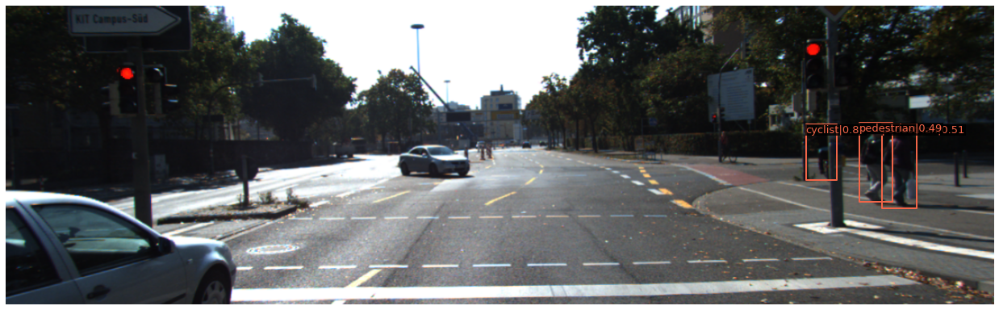

[                                                  ] 1/1781, 0.9 task/s, elapsed: 1s, ETA:  1959s

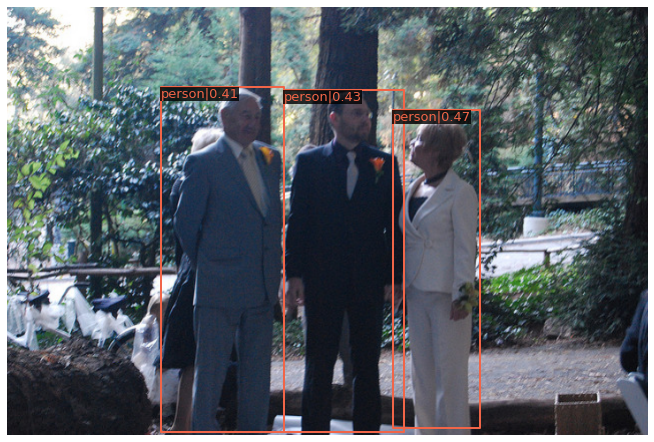

[                                                  ] 2/1781, 1.2 task/s, elapsed: 2s, ETA:  1471s

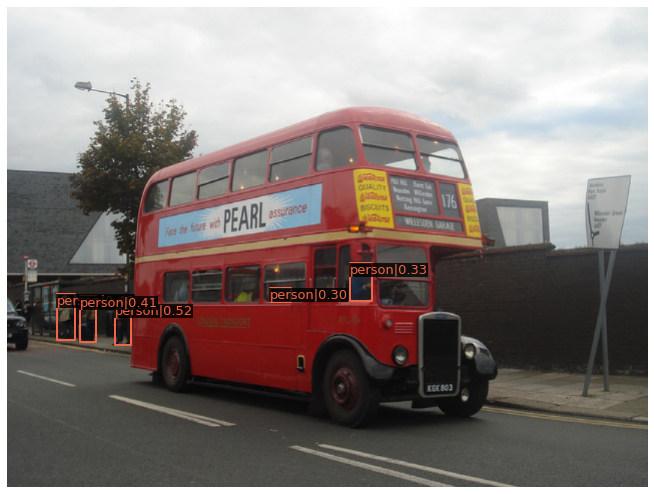

[                                                  ] 3/1781, 1.4 task/s, elapsed: 2s, ETA:  1290s

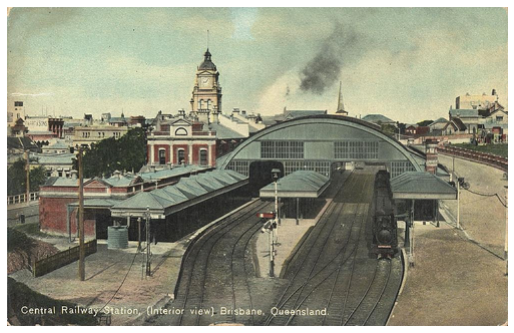

[                                                  ] 4/1781, 1.6 task/s, elapsed: 3s, ETA:  1142s

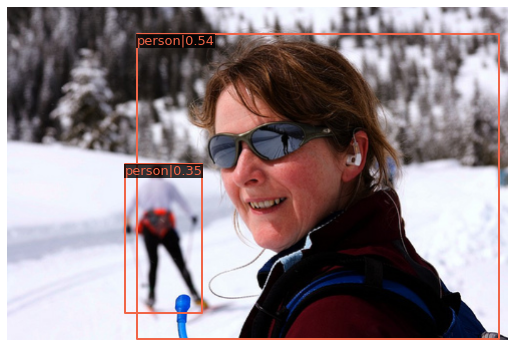

[                                                  ] 5/1781, 1.7 task/s, elapsed: 3s, ETA:  1052s

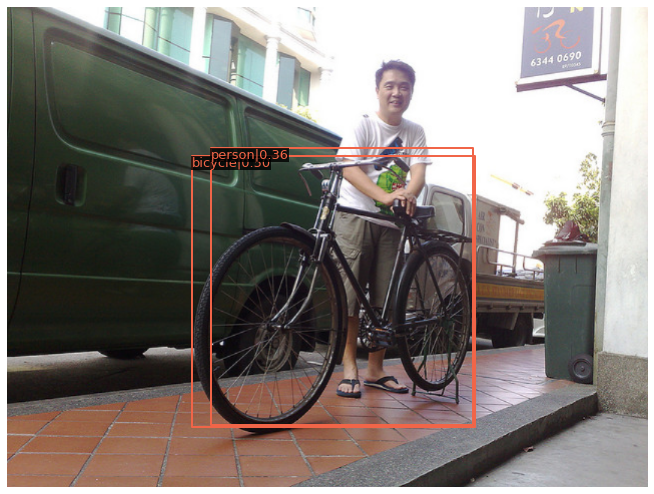

[                                                  ] 6/1781, 1.7 task/s, elapsed: 3s, ETA:  1017s

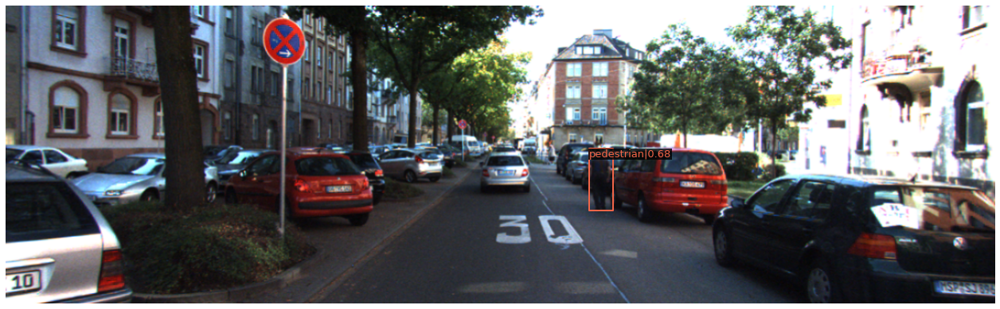

[                                                  ] 7/1781, 1.7 task/s, elapsed: 4s, ETA:  1054s

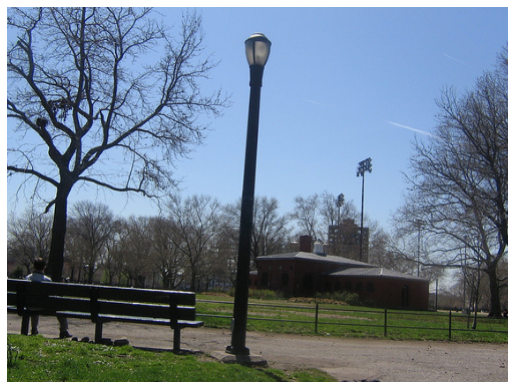

[                                                  ] 8/1781, 1.8 task/s, elapsed: 5s, ETA:   997s

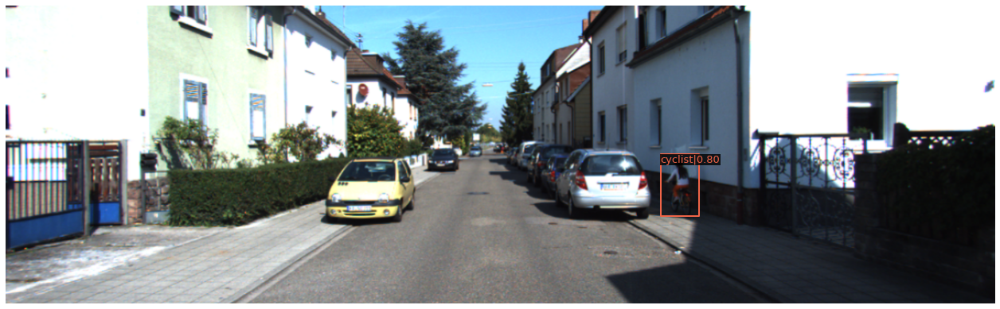

[                                                  ] 9/1781, 1.7 task/s, elapsed: 5s, ETA:  1015s

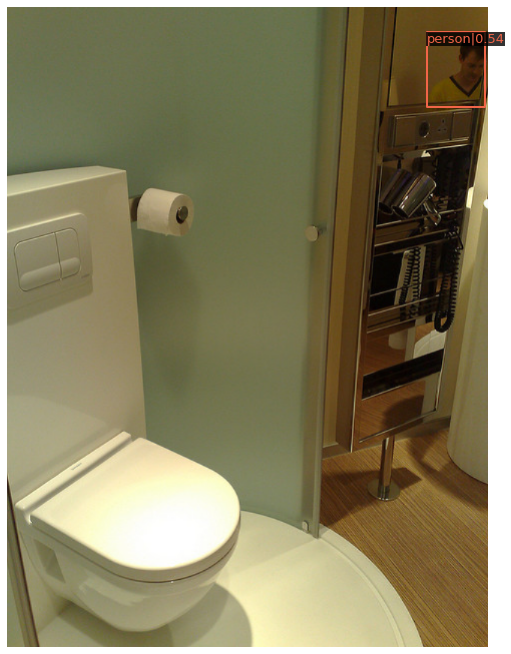

[                                                  ] 10/1781, 1.8 task/s, elapsed: 6s, ETA:   997s

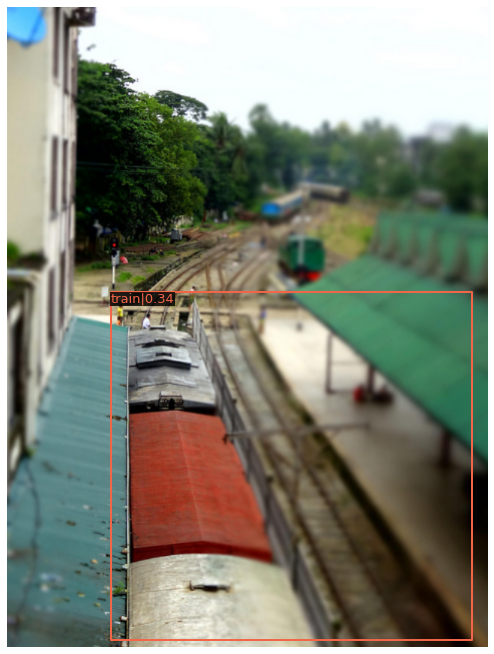

[                                                  ] 11/1781, 1.8 task/s, elapsed: 6s, ETA:   984s

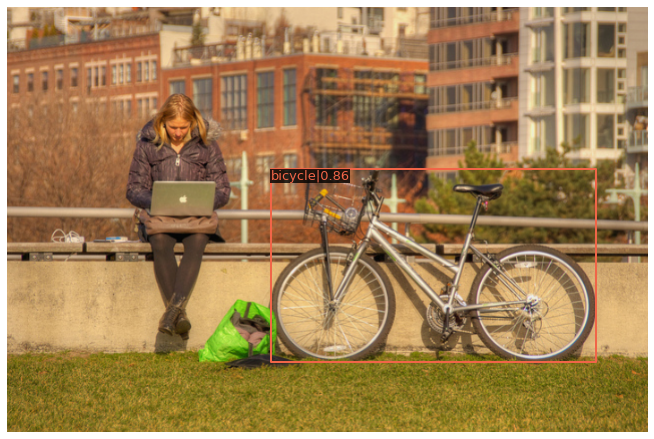

[                                                  ] 12/1781, 1.8 task/s, elapsed: 7s, ETA:   970s

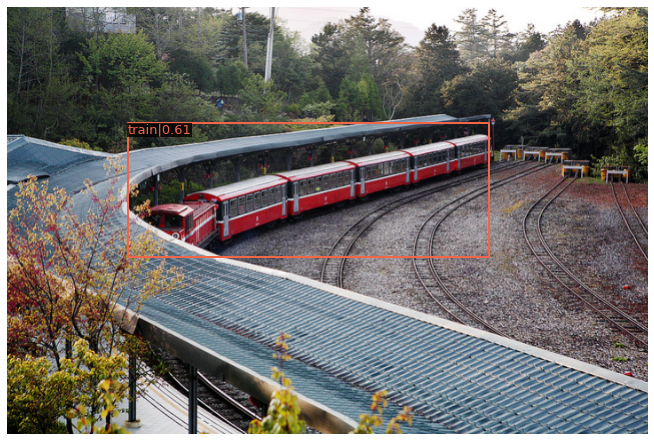

[                                                  ] 13/1781, 1.9 task/s, elapsed: 7s, ETA:   955s

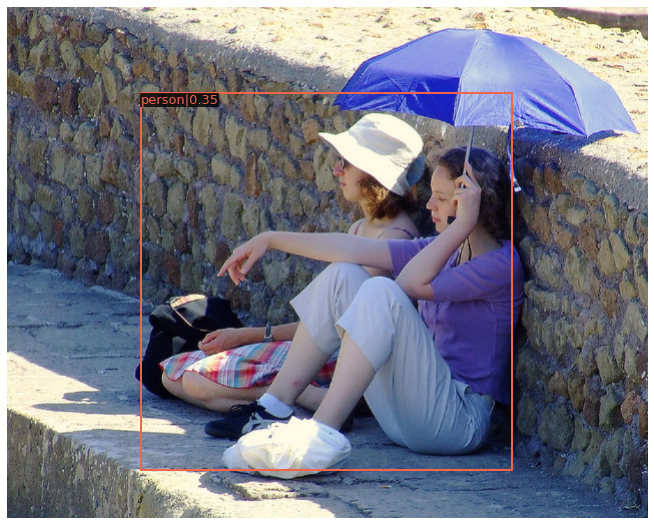

[                                                  ] 14/1781, 1.9 task/s, elapsed: 8s, ETA:   953s

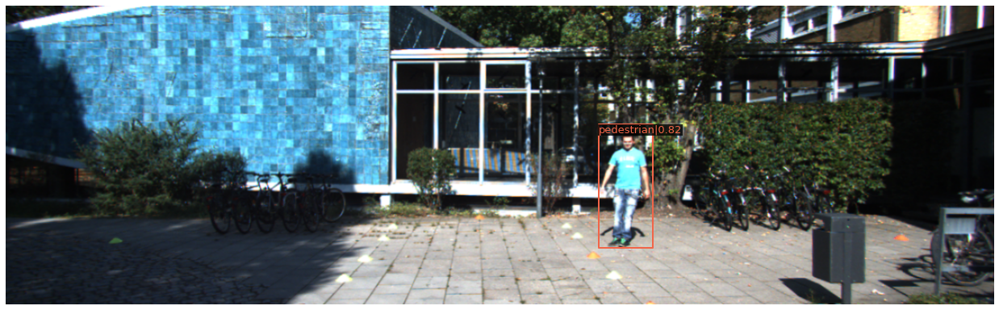

[                                                  ] 15/1781, 1.8 task/s, elapsed: 8s, ETA:   965s

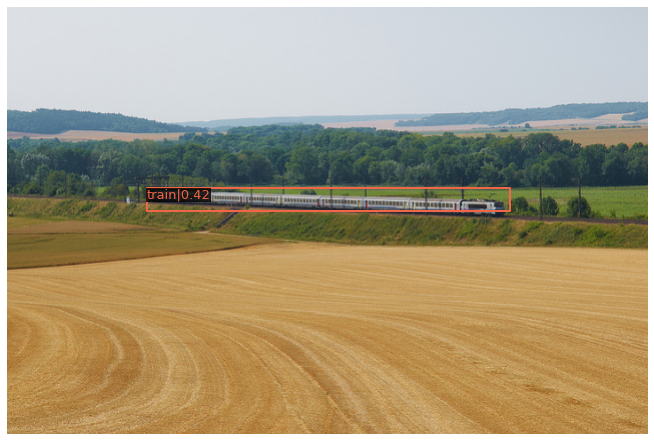

[                                                  ] 16/1781, 1.8 task/s, elapsed: 9s, ETA:   954s

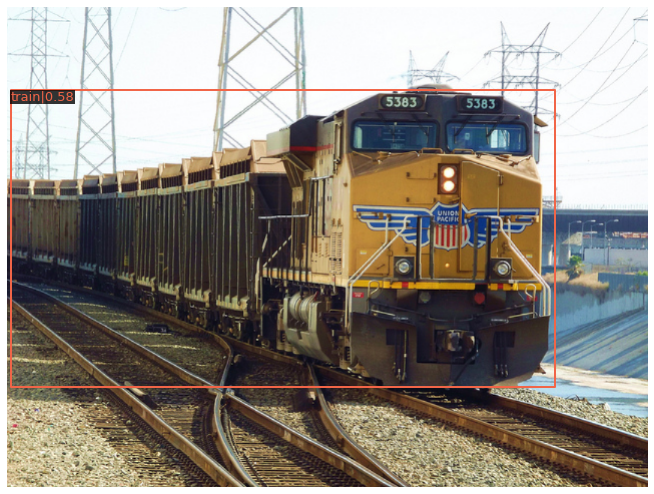

[                                                  ] 17/1781, 1.9 task/s, elapsed: 9s, ETA:   945s

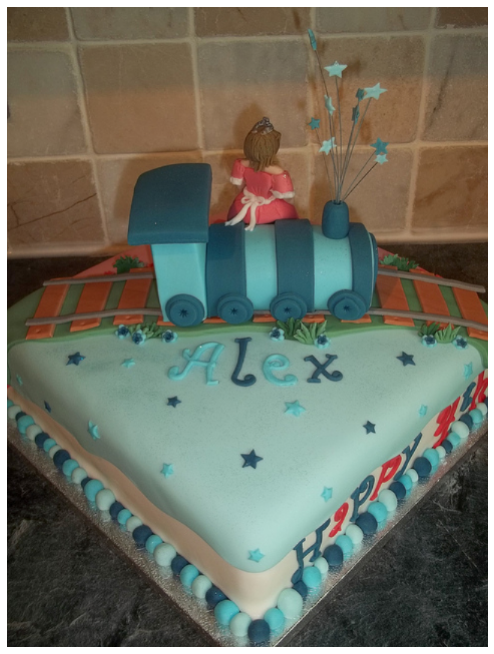

[                                                  ] 18/1781, 1.9 task/s, elapsed: 10s, ETA:   937s

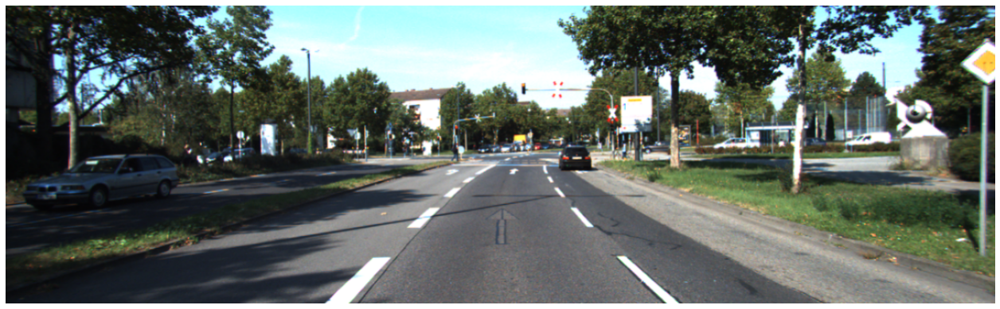

[                                                  ] 19/1781, 1.9 task/s, elapsed: 10s, ETA:   945s

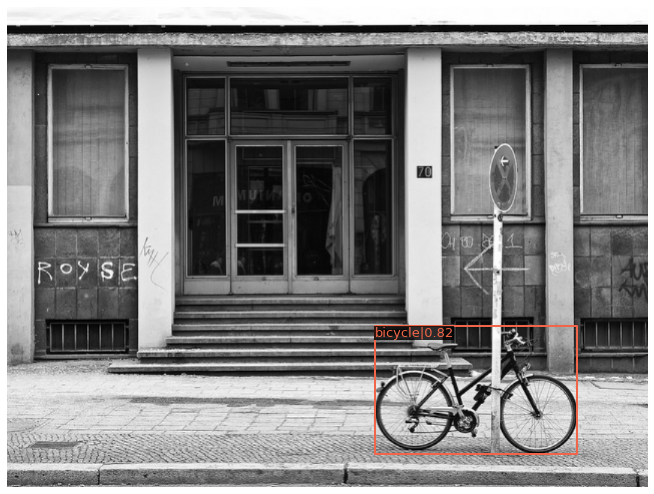

[                                                  ] 20/1781, 1.9 task/s, elapsed: 11s, ETA:   931s

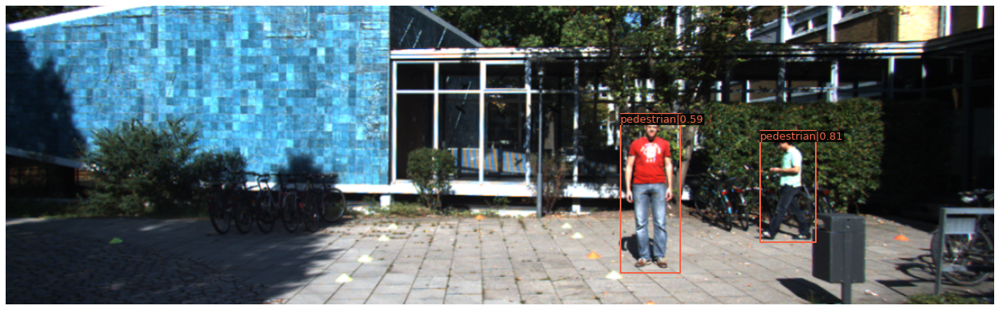

[                                                  ] 21/1781, 1.9 task/s, elapsed: 11s, ETA:   940s

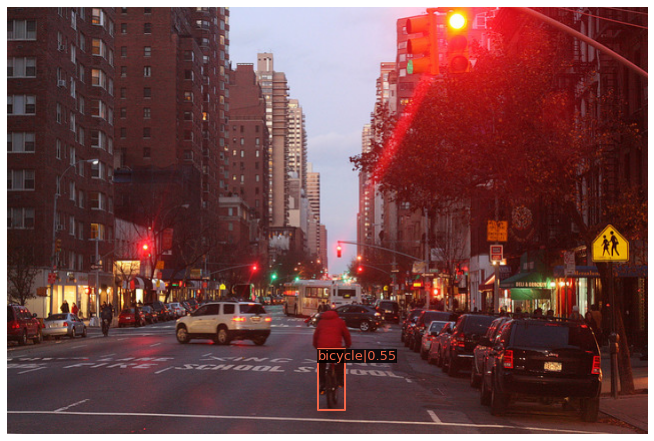

[                                                  ] 22/1781, 1.9 task/s, elapsed: 12s, ETA:   936s

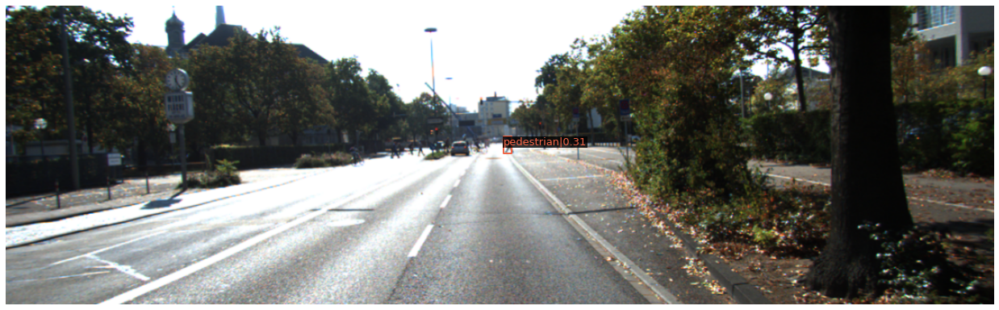

[                                                  ] 23/1781, 1.9 task/s, elapsed: 12s, ETA:   943s

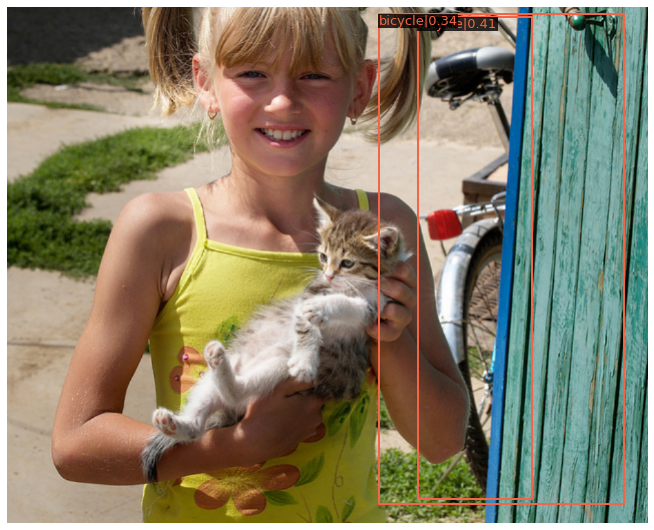

[                                                  ] 24/1781, 1.9 task/s, elapsed: 13s, ETA:   946s

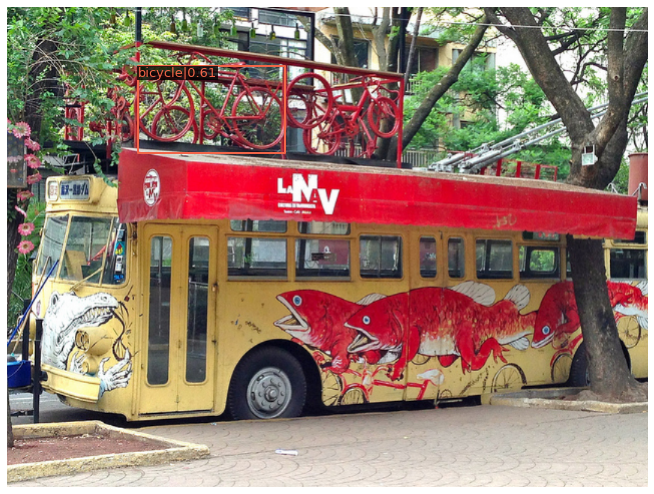

[                                                  ] 25/1781, 1.9 task/s, elapsed: 13s, ETA:   943s

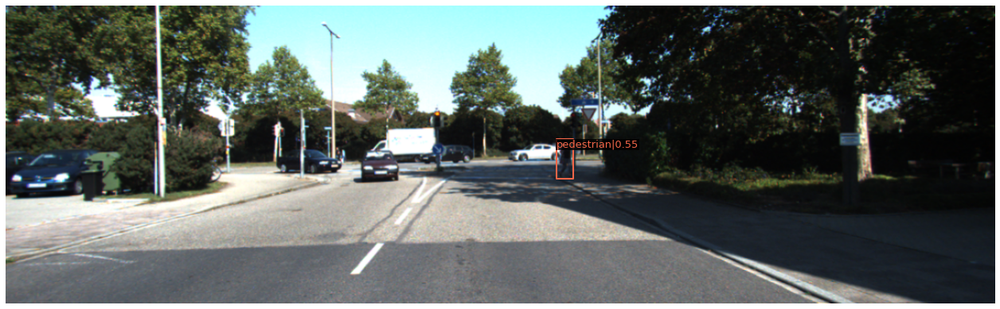

[                                                  ] 26/1781, 1.8 task/s, elapsed: 14s, ETA:   950s

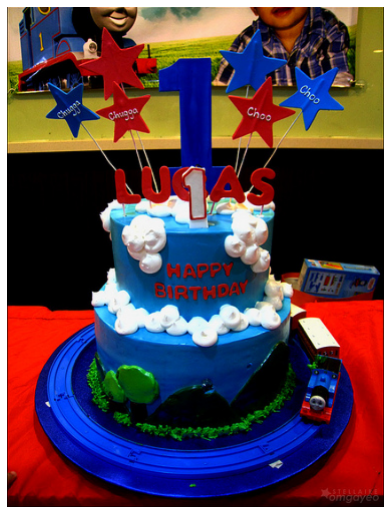

[                                                  ] 27/1781, 1.9 task/s, elapsed: 14s, ETA:   937s

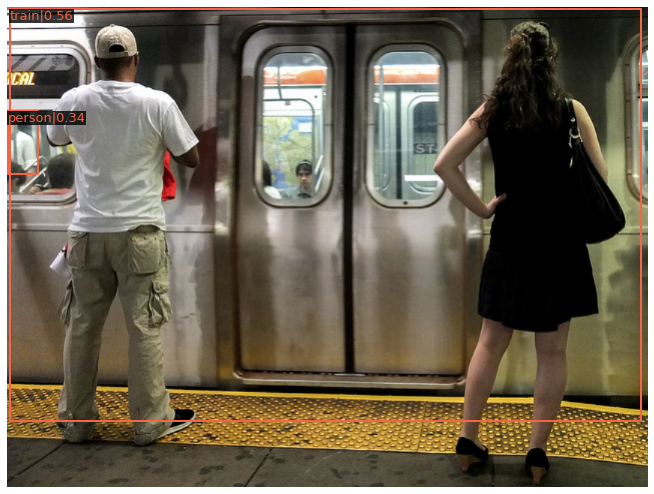

[                                                  ] 28/1781, 1.9 task/s, elapsed: 15s, ETA:   932s

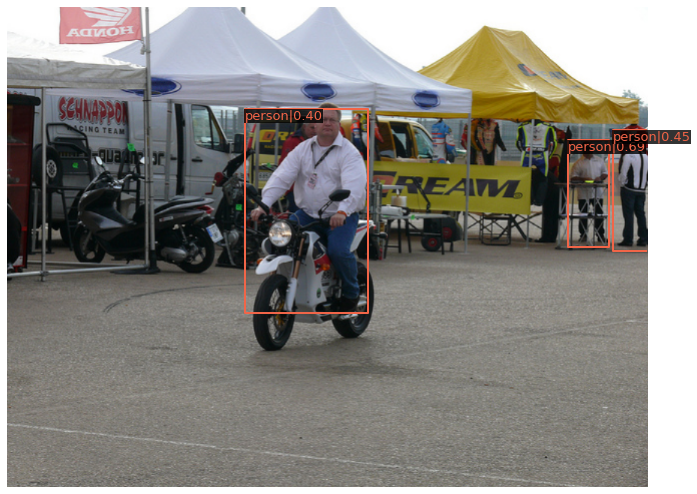

[                                                  ] 29/1781, 1.9 task/s, elapsed: 15s, ETA:   933s

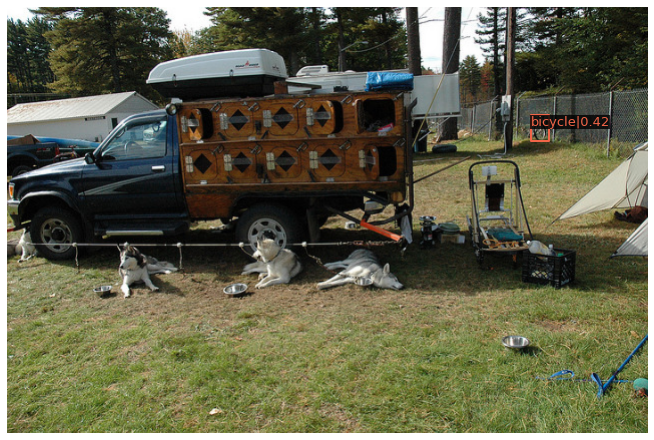

[                                                  ] 30/1781, 1.9 task/s, elapsed: 16s, ETA:   928s

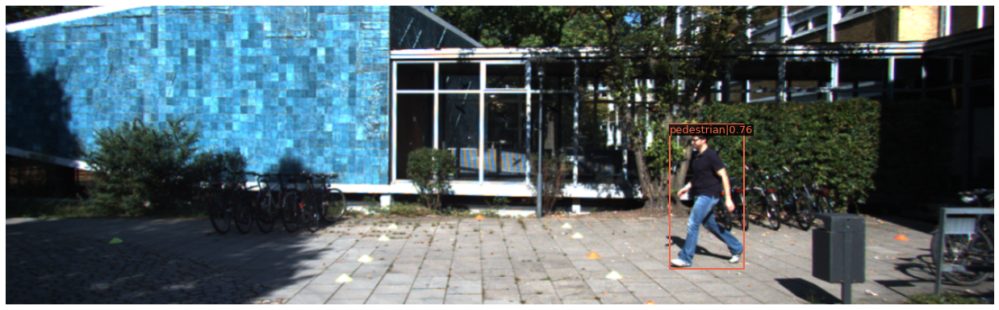

[                                                  ] 31/1781, 1.9 task/s, elapsed: 17s, ETA:   935s

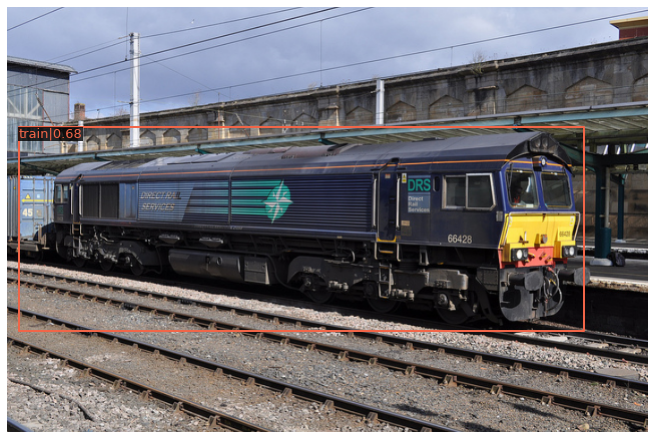

[                                                  ] 32/1781, 1.9 task/s, elapsed: 17s, ETA:   931s

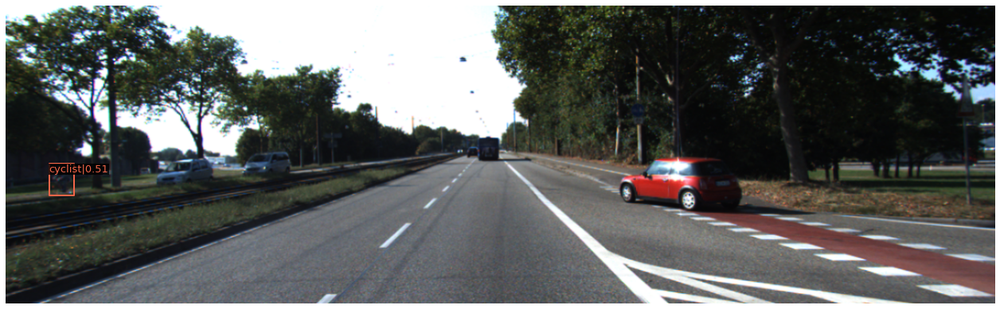

[                                                  ] 33/1781, 1.9 task/s, elapsed: 18s, ETA:   938s

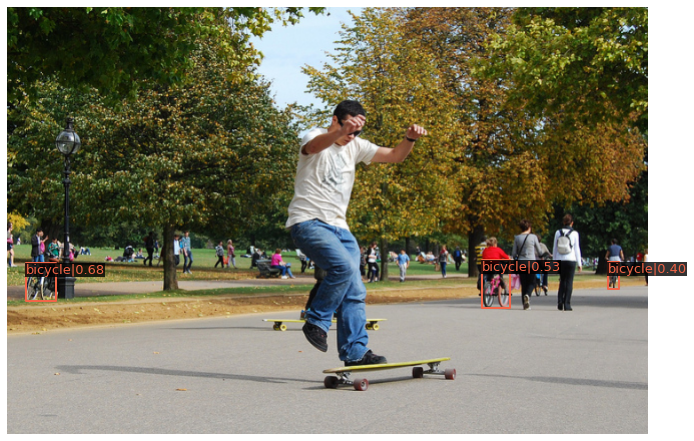

[                                                  ] 34/1781, 1.9 task/s, elapsed: 18s, ETA:   935s

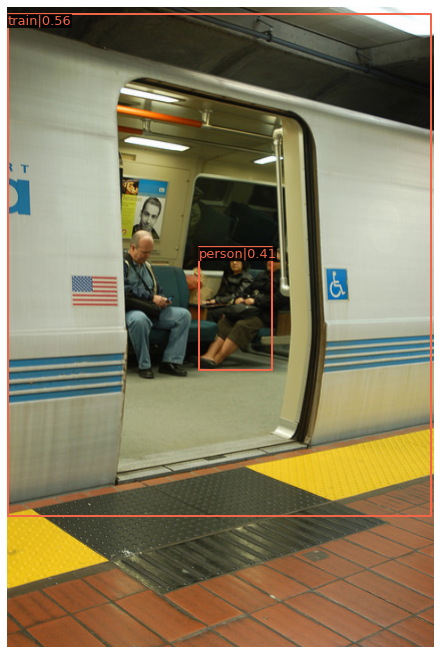

[                                                  ] 35/1781, 1.9 task/s, elapsed: 19s, ETA:   931s

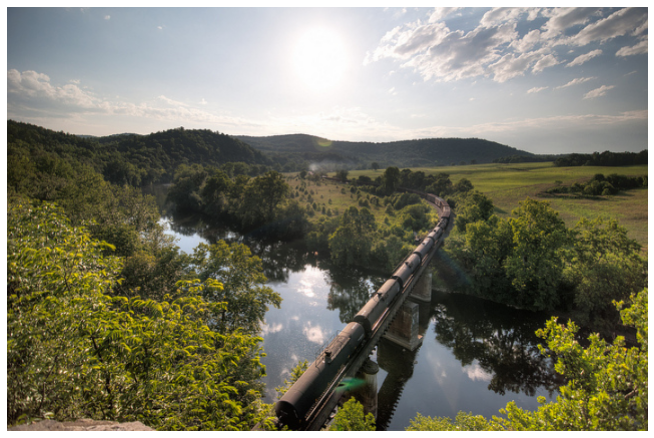

[>                                                 ] 36/1781, 1.9 task/s, elapsed: 19s, ETA:   926s

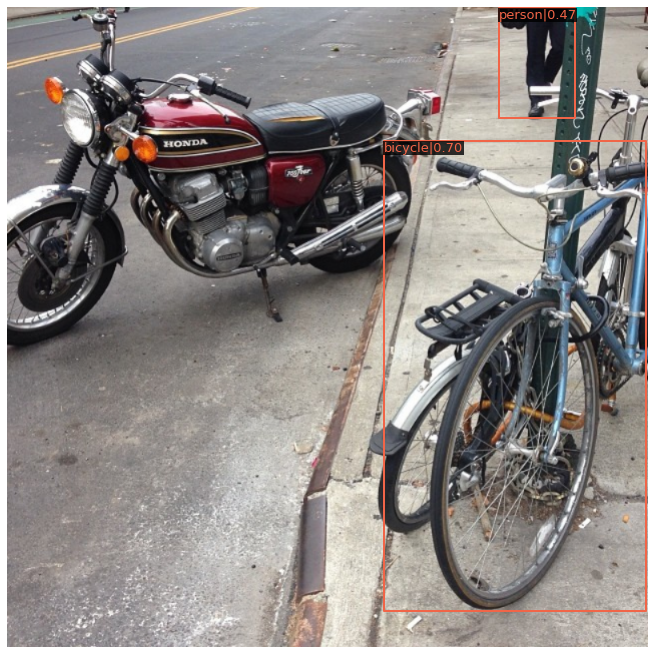

[>                                                 ] 37/1781, 1.9 task/s, elapsed: 20s, ETA:   928s

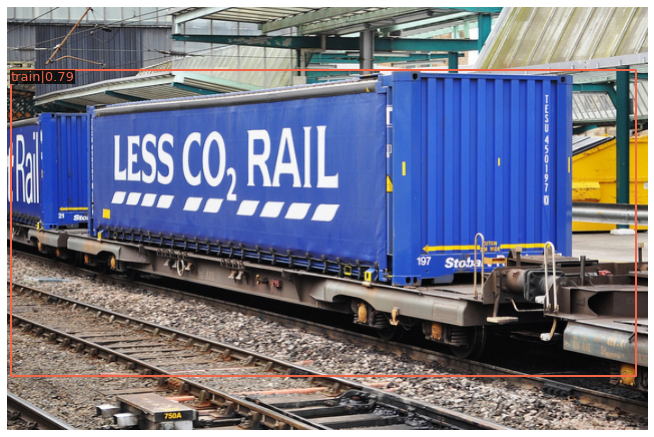

[>                                                 ] 38/1781, 1.9 task/s, elapsed: 20s, ETA:   924s

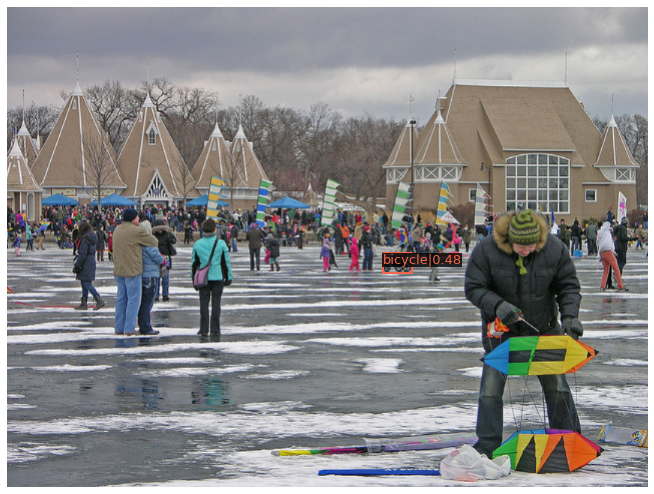

[>                                                 ] 39/1781, 1.9 task/s, elapsed: 21s, ETA:   922s

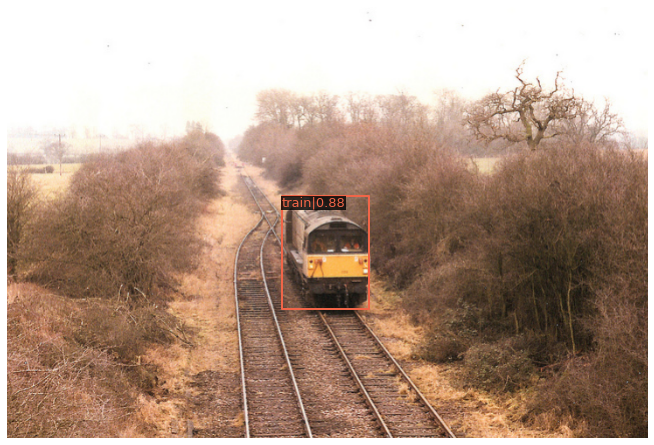

[>                                                 ] 40/1781, 1.9 task/s, elapsed: 21s, ETA:   916s

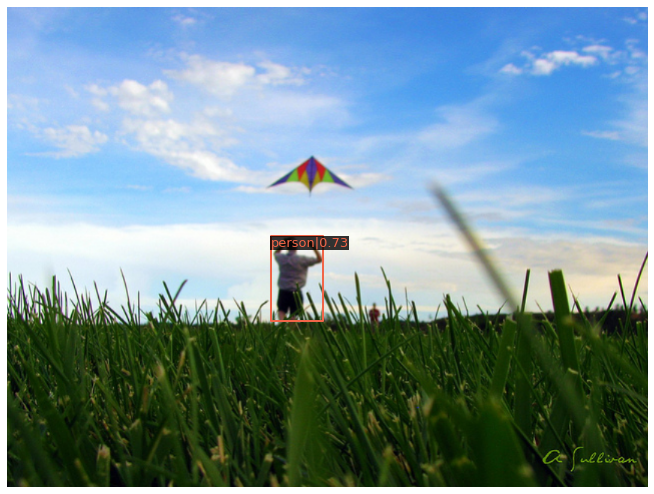

[>                                                 ] 41/1781, 1.9 task/s, elapsed: 22s, ETA:   915s

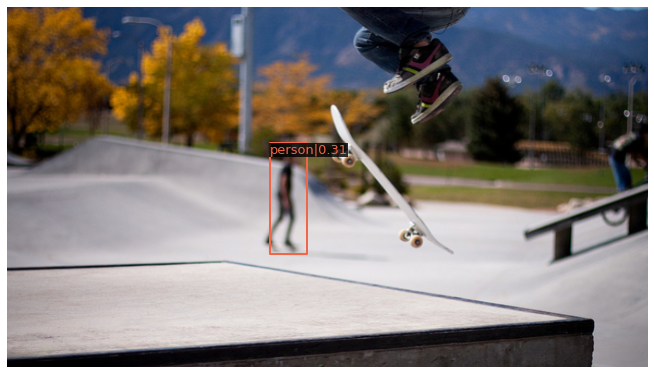

[>                                                 ] 42/1781, 1.9 task/s, elapsed: 22s, ETA:   911s

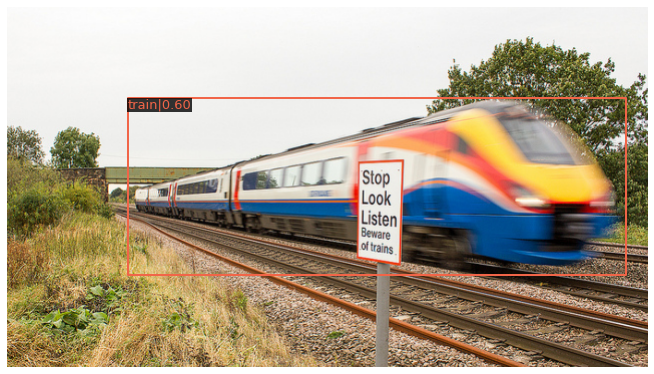

[>                                                 ] 43/1781, 1.9 task/s, elapsed: 22s, ETA:   906s

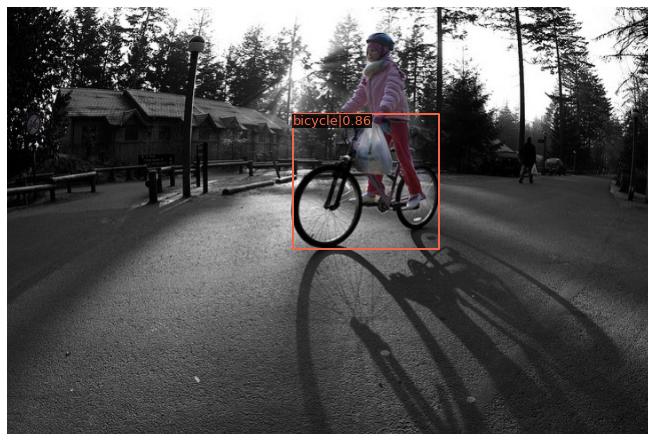

[>                                                 ] 44/1781, 1.9 task/s, elapsed: 23s, ETA:   901s

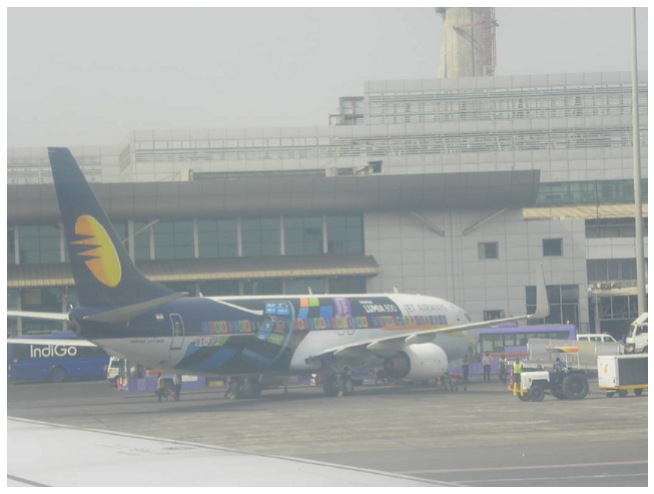

[>                                                 ] 45/1781, 1.9 task/s, elapsed: 23s, ETA:   897s

In [ ]:
%run mmdetection/tools/test.py \
mmdetection/configs/fcos/fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile.py \
mmdetection/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.01/latest.pth \
--work-dir mmdetection/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.01/ \
--out mmdetection/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.01/result_test_person.pkl \
--cfg-options data.test.ann_file={path_to_test} \
model.bbox_head.num_classes={number_of_categories} \
data.samples_per_gpu=4 \
data.train.classes="$categories" \
data.val.classes="$categories" \
data.test.classes="$categories" \
--eval bbox \
--show

In [ ]:
# training on original labels without coco pre_trained weights

In [ ]:
%run mmdetection/tools/train.py \
mmdetection/configs/fcos/fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile-WithoutPretrain.py \
--work-dir mmdetection/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.05_WithoutPretrain/ \
--cfg-options model.bbox_head.num_classes={number_of_categories} \
data.train.ann_file={path_to_train} \
data.val.ann_file={path_to_val} \
runner.max_epochs=100 \
data.samples_per_gpu=4 \
data.train.classes="$categories" \
data.val.classes="$categories" \
data.test.classes="$categories"

In [ ]:
# testing on original labels without coco pre_trained weights

In [ ]:
%run mmdetection/tools/test.py \
mmdetection/configs/fcos/fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile-WithoutPretrain.py \
mmdetection/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.05_WithoutPretrain/latest.pth \
--work-dir mmdetection/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.05_WithoutPretrain/ \
--out mmdetection/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.05_WithoutPretrain/result_test_person.pkl \
--cfg-options data.test.ann_file={path_to_test} \
model.bbox_head.num_classes={number_of_categories} \
data.samples_per_gpu=4 \
data.train.classes="$categories" \
data.val.classes="$categories" \
data.test.classes="$categories" \
--eval bbox \
--show

In [ ]:
# train_merged_labels_without_pretrained

In [ ]:
number_of_categories = 4
fuzzy_path = 'mmdetection/data/mixedDataset/annotations/instances_{}2017_PersonCyclistBicycleTrain_merged.json'
path_to_train = fuzzy_path.format('train')
path_to_val = fuzzy_path.format('val')
path_to_test = fuzzy_path.format('test')
categories = ['train', 'cyclist', 'bicycle', 'person']

In [ ]:
# testing_merged_labels_without_pretrained

In [ ]:
%run mmdetection/tools/test.py \
mmdetection/configs/fcos/fcos_r50_caffe_fpn_gn-head_1x_mixedDataset_loadFromSeparatedFile-WithoutPretrain.py \
mmdetection/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.05_WithoutPretrain_mergedLabels/latest.pth \
--work-dir mmdetection/training_logs_example/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.05_WithoutPretrain_mergedLabels/ \
--out mmdetection/training_logs_example/training_logs_example/fcos_coco_kitti_PedestrianCyclistTram_PersonBicycleTrain_bacth_4_lr_0.05_WithoutPretrain_mergedLabels/result_test_person.pkl \
--cfg-options data.test.ann_file={path_to_test} \
model.bbox_head.num_classes={number_of_categories} \
data.samples_per_gpu=4 \
data.train.classes="$categories" \
data.val.classes="$categories" \
data.test.classes="$categories" \
--eval bbox \
--show